In [1]:
import os
import cv2
import csv
import time
import tensorflow as tf
import keras
import glob
from PIL import Image
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Input, Activation,Concatenate
from tensorflow.keras.layers import BatchNormalization, LeakyReLU, Flatten, Dense, Dropout, UpSampling2D
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.figure import Figure
from mpl_toolkits.axes_grid1 import ImageGrid
from pprint import pprint
%matplotlib inline
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from tensorflow.keras.callbacks import EarlyStopping
import logging
logging.getLogger('tensorflow').disabled = True
import warnings
warnings.filterwarnings('ignore', category=UserWarning)

# Image Augmentation Functions

In [2]:
from scipy.ndimage import binary_erosion
import random
import math

def flip_horizontal(img):
    background = tf.constant([-1.0, -1.0, -1.0])
    mask = tf.math.greater(img, background)
    # print("mask.shape", tf.shape(mask), mask.shape)
    tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
    mask = tf.math.logical_or(mask[:,:,2], tmp)
    # print("mask.shape", tf.shape(mask), mask.shape)
    #print("mask.dtype", mask.dtype)
    #mask = tf.cast(mask, tf.bool)
    mshape = tf.shape(mask)
    mask = tf.reshape(mask, [mshape[0], mshape[1], 1]) #mshape[2], 1])
    mshape = tf.shape(mask)
    flipped = tf.image.flip_left_right(img)
    mask = tf.image.flip_left_right(mask)
    mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
    kernel = tf.zeros([3, 3, mshape[2]])#mshape[3]]) 
    mask = tf.reshape(mask, [1, mshape[0], mshape[1], 1])
    mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
    mask = tf.math.greater(mask, 0.0)
    mask = tf.reshape(mask, [mshape[0], mshape[1], 1])
    
    # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
    # So left-right flip means negating the green channel
    mat = [[1.0,0.0,0.0],[0.0,-1.0,0.0],[0.0,0.0,1.0]]
    mult = tf.linalg.matvec(mat, flipped)
    fshape = tf.shape(flipped)
    # print("flipped.shape", flipped.shape)
    flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
    return flipped


def myrotate(img):
    return tf.keras.preprocessing.image.apply_affine_transform(img, theta=angle, zx=zoom, zy=zoom)


def random_rotate(img):
    #res = []
    res = tf.TensorArray(tf.float32, size=0, dynamic_size=True)
    ishape = tf.shape(img)
    for i in range(ishape[0]):
        global angle, zoom
        angle = (random.random()-0.5)*40 # plus or minus 20 degree in degrees (0.1745 radians)
        zoom = 1.0 + (random.random()-0.5)*0.2
        # print("angle", angle)
        background = tf.constant([-1.0, -1.0, -1.0])
        mask = tf.math.greater(img[i, :,:,:], background)
        tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
        mask = tf.math.logical_or(mask[:,:,2], tmp)
        mshape = tf.shape(mask)
        mask = tf.reshape(mask, [mshape[0], mshape[1], -1])
        img_i = img[i, :,:,:]
        # print("img_i.shape", tf.shape(img_i))
        img_i = tf.transpose(img_i, [2, 0, 1])
        #flipped = tf.keras.preprocessing.image.apply_affine_transform(img_i, theta=angle, zx=zoom, zy=zoom) #, row_axis=0, col_axis=1, channel_axis=2)
        #flipped = tf.py_function(func=tf.keras.preprocessing.image.apply_affine_transform, inp=(img_i, theta=angle, zx=zoom, zy=zoom), Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
        flipped = tf.py_function(func=myrotate, inp=[img_i], Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
        flipped = tf.transpose(flipped, [1, 2, 0])
        mask = tf.transpose(mask, [2,0,1])
        mshape = tf.shape(mask)
        mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
        #mask = tf.keras.preprocessing.image.apply_affine_transform(mask, theta=angle, zx=zoom, zy=zoom)
        mask = tf.py_function(func=myrotate, inp=[mask], Tout=tf.float32)
        mask = tf.math.greater(mask, 0.0)
        mask = tf.transpose(mask, [1,2,0])
        #mask = tf.where(mask, tf.ones(mask.shape), tf.zeros(mask.shape))
        #kernel = tf.zeros([3, 3, mask.shape[2]]) 
        #mask = tf.reshape(mask, [1, mask.shape[0], mask.shape[1], mask.shape[2]])
        #mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
        #mask = tf.math.greater(mask, 0.0)
        #mask = tf.reshape(mask, [mask.shape[1], mask.shape[2], mask.shape[3]])
        
        # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
        # So left-right flip means negating the green channel
        angle = math.pi*angle/180.0
        mat = [[1.0,0.0,0.0],[0.0,math.cos(angle),math.sin(angle)],[0.0,-math.sin(angle),math.cos(angle)]]
        #print("flipped.shape", flipped.shape)
        mult = tf.linalg.matvec(mat, flipped)
        fshape = tf.shape(flipped)
    
        flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
        #res.append(flipped)
        res = res.write(res.size(), flipped)
    flipped = res.stack()#tf.stack(res)
    # print("flipped.shape", tf.shape(flipped))
    return flipped

def random_rotate_single(img):
    global angle, zoom
    angle = (random.random()-0.5)*40 # plus or minus 20 degree in degrees (0.1745 radians)
    zoom = 1.0 + (random.random()-0.5)*0.2
    # # print("angle", angle)
    background = tf.constant([-1.0, -1.0, -1.0])
    mask = tf.math.greater(img, background)
    tmp = tf.math.logical_or(mask[:,:,0], mask[:,:,1])
    mask = tf.math.logical_or(mask[:,:,2], tmp)
    mshape = tf.shape(mask)
    mask = tf.reshape(mask, [mshape[0], mshape[1], -1])
    # print("img.shape", tf.shape(img))
    img = tf.transpose(img, [2, 0, 1])
    #flipped = tf.keras.preprocessing.image.apply_affine_transform(img_i, theta=angle, zx=zoom, zy=zoom) #, row_axis=0, col_axis=1, channel_axis=2)
    #flipped = tf.py_function(func=tf.keras.preprocessing.image.apply_affine_transform, inp=(img_i, theta=angle, zx=zoom, zy=zoom), Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
    flipped = tf.py_function(func=myrotate, inp=[img], Tout=tf.float32) #, row_axis=0, col_axis=1, channel_axis=2)
    flipped = tf.transpose(flipped, [1, 2, 0])
    mask = tf.transpose(mask, [2,0,1])
    mshape = tf.shape(mask)
    mask = tf.where(mask, tf.ones(mshape), tf.zeros(mshape))
    #mask = tf.keras.preprocessing.image.apply_affine_transform(mask, theta=angle, zx=zoom, zy=zoom)
    mask = tf.py_function(func=myrotate, inp=[mask], Tout=tf.float32)
    mask = tf.math.greater(mask, 0.0)
    mask = tf.transpose(mask, [1,2,0])
    #mask = tf.where(mask, tf.ones(mask.shape), tf.zeros(mask.shape))
    #kernel = tf.zeros([3, 3, mask.shape[2]]) 
    #mask = tf.reshape(mask, [1, mask.shape[0], mask.shape[1], mask.shape[2]])
    #mask = tf.nn.erosion2d(mask, kernel, (1,1,1,1), "SAME", "NHWC", (1,1,1,1))
        
    #mask = tf.math.greater(mask, 0.0)
    #mask = tf.reshape(mask, [mask.shape[1], mask.shape[2], mask.shape[3]])
        
    # Assuming blue is out of screen, green is to the (viewer's) right, and red is down?
    # So left-right flip means negating the green channel
    angle = math.pi*angle/180.0
    mat = [[1.0,0.0,0.0],[0.0,math.cos(angle),math.sin(angle)],[0.0,-math.sin(angle),math.cos(angle)]]
    #print("flipped.shape", flipped.shape)
    mult = tf.linalg.matvec(mat, flipped)
    fshape = tf.shape(flipped)
    
    flipped = tf.where(mask, mult, tf.ones(fshape)*-1.0)
        
    return flipped
#flipped_dataset = train_dataset.map(flip_horizontal)

def applyFlip(ds):
  return train_dataset.map(flip_horizontal)

def applyRotate(ds):
  return train_dataset.map(random_rotate_single)

def flipRotate(img):
  img = flip_horizontal(img)
  img = random_rotate_single(img)
  return img
  
def applyFlipRotate(ds):
  return train_dataset.map(flipRotate)
  
# for images in train_dataset.take(1):
#     flip = flip_horizontal(images)
#     print("images.shape", images.shape)
    
#     flip = random_rotate(flip)
#     print("flip.shape", flip.shape)
#     for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), flip):
#         ax.imshow((img+1)/2)
#         ax.axis('off')
#     for ax, img in zip(ImageGrid(plt.figure(figsize=(12, 8)), 111, nrows_ncols=(2, 3), axes_pad=0.3), images):
#         ax.imshow((img+1)/2)
#         ax.axis('off')

# plt.suptitle('Examples Of Six Training Images from flipped dataset', fontsize='xx-large',fontweight='heavy')
# plt.show()

# Preparation and presentation of datasets

### Acquire and Preprocess Dataset

In [3]:
BATCH_SIZE = 15

img_dir = '../dataset/sfs-net/'

train_files = glob.glob(img_dir + 'train/0003/*normal*.png')
test_files = glob.glob(img_dir + 'test/0603/*normal*.png')

def preprocess(images):
    images = tf.image.resize(images, [256, 256])
    images = tf.cast(images, tf.float32)
    images = (images - 127.5) / 127.5 # [-1, 1]
    return images


def load_and_preprocess_image(file_path):
    # print("file_path", file_path)
    # Load the image from file
    image = tf.io.read_file(file_path)
    # Decode the image to a tensor
    image = tf.image.decode_jpeg(image, channels=3)
    # Preprocess the image
    image = preprocess(image)
    return image


def normalise(images):
    images,images_norm = tf.linalg.normalize(images, axis=2) #Normalise the input data
    return images


train_dataset = tf.data.Dataset.from_tensor_slices(train_files)
test_dataset = tf.data.Dataset.from_tensor_slices(test_files)

print("Original training dataset size:", len(train_files))
print("Original testing dataset size:", len(test_files))

train_dataset = train_dataset.map(load_and_preprocess_image)
test_dataset = test_dataset.map(load_and_preprocess_image)
img = train_dataset.take(1)
print("Original - img.element_spec", img.element_spec)
train_dataset_width = int(img.element_spec.shape[0])
train_dataset_height = int(img.element_spec.shape[1])

# augmentations
flipped_dataset = train_dataset.map(flip_horizontal)#apply(applyFlip)#
rotated_dataset = train_dataset.map(random_rotate_single)#apply(applyRotate)#
flipped_rotated = train_dataset.map(flipRotate)#apply(applyFlipRotate)#apply(applyFlip).apply(applyRotate)

train_dataset = train_dataset.concatenate(rotated_dataset)
train_dataset = train_dataset.concatenate(flipped_dataset)
train_dataset = train_dataset.concatenate(flipped_rotated)

#train_dataset.save(img_dir + 'train/augmented/')
#train_dataset = tf.data.Dataset.load(img_dir + 'train/augmented/')

train_dataset = train_dataset.map(normalise)
test_dataset = test_dataset.map(normalise)

print("Augmented training dataset size:", len(list(train_dataset)))
print("Augmented testing dataset size:", len(list(test_dataset)))

train_dataset = train_dataset.shuffle(len(train_files)*2).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
test_dataset = test_dataset.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)

print("Total number of batches in training dataset:", len(list(train_dataset)))
print("Total number of batches in testing dataset:", len(list(test_dataset)))
print("train dataset: ", tf.data.DatasetSpec.from_value(train_dataset))
print("test dataset: ", tf.data.DatasetSpec.from_value(test_dataset))

train_dataset = train_dataset.prefetch(100).cache()

Original training dataset size: 300
Original testing dataset size: 105
Original - img.element_spec TensorSpec(shape=(256, 256, 3), dtype=tf.float32, name=None)
Augmented training dataset size: 1200
Augmented testing dataset size: 105
Total number of batches in training dataset: 80
Total number of batches in testing dataset: 7
train dataset:  DatasetSpec(TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name=None), TensorShape([]))
test dataset:  DatasetSpec(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorShape([]))


### Show some images on the train dataset

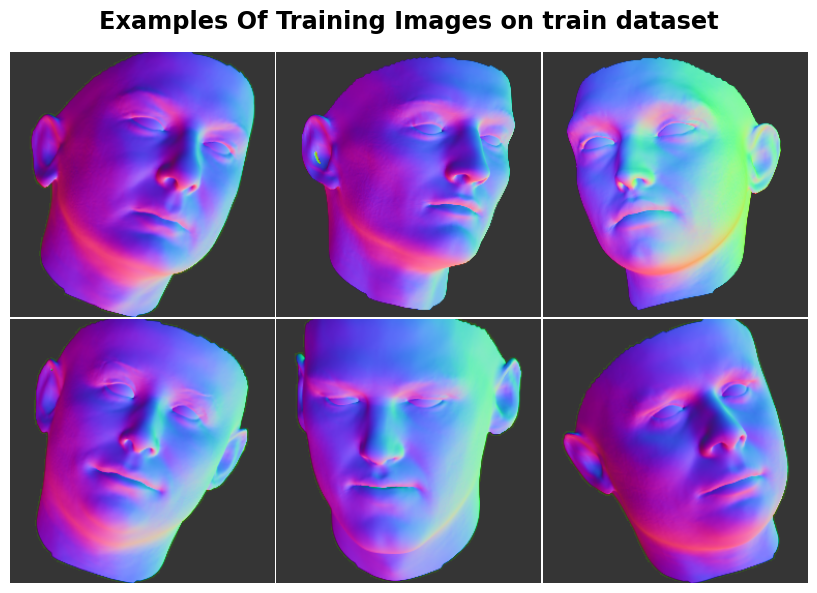

In [4]:
for images in train_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Training Images on train dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Show some images on the test dataset

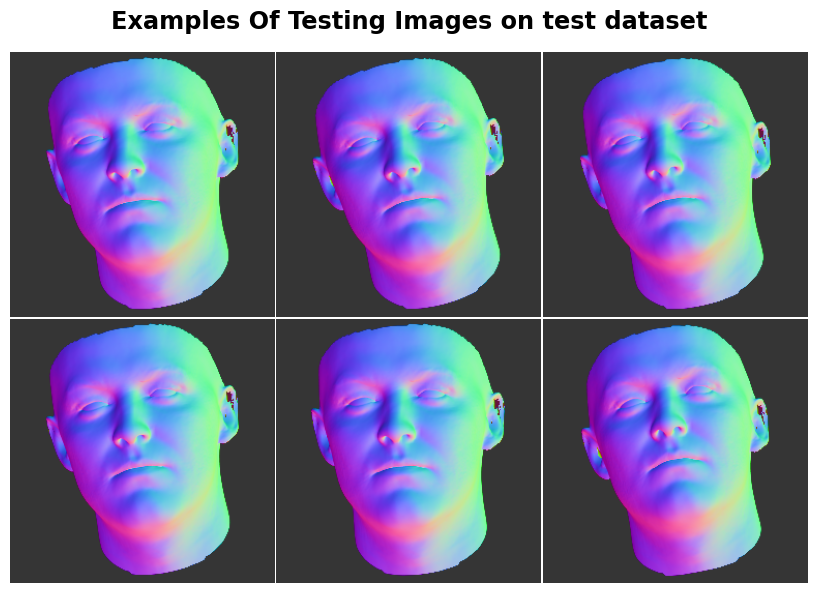

In [5]:
for images in test_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Testing Images on test dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

# Mask Code Set

### Generate Irregular Mask (batch size)

In [6]:
def mask_irregular(batch_size, mask_width, mask_height):
    
    size = int(round((mask_width + mask_height) * 0.03))
    mask = np.zeros((batch_size,mask_width,mask_height,1))
    
    for _ in range(np.random.randint(1, 20)):
        
        x1, x2 = np.random.randint(1, mask_width, batch_size), np.random.randint(1, mask_width, batch_size)
        y1, y2 = np.random.randint(1, mask_height, batch_size), np.random.randint(1, mask_height, batch_size)
        thickness = np.random.randint(1, size, batch_size)
        
        for i in range(batch_size):
            cv2.line(mask[i],(x1[i], y1[i]),(x2[i],y2[i]),(1,1,1), thickness[i])

    return np.float32(((1 - mask)*2) - 1) # [-1, 1]

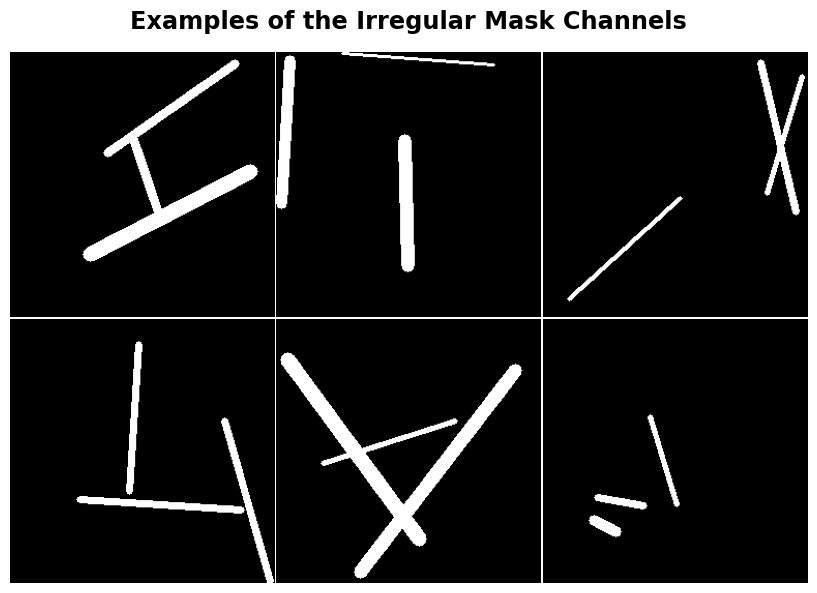

In [7]:
irregular_mask_examples = mask_irregular(6, train_dataset_width, train_dataset_height)

for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), 
                   irregular_mask_examples):
    ax.imshow((img+1)/2, cmap='binary')
    ax.axis('off')
plt.suptitle('Examples of the Irregular Mask Channels', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Generate the masked imgs (batch size)

In [8]:
def masked_imgs(raw_imgs, mask_channels):
    
    raw_imgs = (raw_imgs + 1.0) / 2.0 # [0, 1]
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    
    # masked_images = np.multiply(raw_imgs, mask_channels)
    masked_images = tf.multiply(raw_imgs, mask_channels)  # 使用 tf.multiply 替代 np.multiply
    
    masked_images = (masked_images * 2.0) - 1.0 # [-1, 1]
    
#     masked_images[:][masked_images[:] == 0] = 1. # Set the white mask
    
    return masked_images

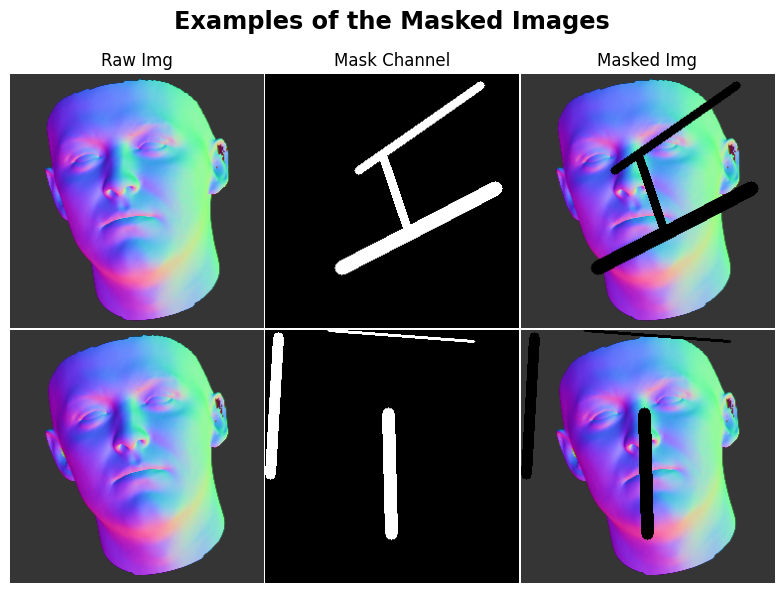

In [9]:
for images_batch in test_dataset.take(1):
    raw_images_examples = images_batch[:2]

irregular_mask_examples = irregular_mask_examples[:2]
masked_images_examples = masked_imgs(raw_images_examples, irregular_mask_examples)

grid = ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3))

for i in range(2):
    ax = grid[i*3]
    ax.imshow((raw_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Raw Img')
    
    ax = grid[i*3+1]
    ax.imshow((irregular_mask_examples[i]+1)/2, cmap='binary')
    ax.axis('off')
    if i == 0:
        ax.set_title('Mask Channel')
    
    ax = grid[i*3+2]
    ax.imshow((masked_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Masked Img')
    
plt.suptitle('Examples of the Masked Images', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Generate the pred only masked region imgs (batch size)

In [10]:
def only_masked_region_pred_imgs(mask_channels, masked_imgs, pred_imgs):
    
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    masked_imgs = (masked_imgs + 1.0) / 2.0 # [0, 1]
    pred_imgs = (pred_imgs + 1.0) / 2.0 # [0, 1]
    
    masked_region_pred_imgs = masked_imgs + pred_imgs * (1.0 - mask_channels)
    
    masked_region_pred_imgs = (masked_region_pred_imgs * 2.0) - 1.0 # [-1, 1]
    
    return masked_region_pred_imgs

# Painting Function

In [11]:
def generator_plot_images(gen_model, text, dataset, num=3, save_path='./saved_images', epoch=0, save_images=False):
    os.makedirs(save_path, exist_ok=True)
    
    for images_batch in dataset.take(1):
        raw_images = images_batch
        mask_channels = mask_irregular(raw_images.shape[0], raw_images.shape[1], raw_images.shape[2])
        masked_images = masked_imgs(raw_images, mask_channels)
        pred_images = gen_model([masked_images, mask_channels], training=False)
        pred_images, pred_norm = tf.linalg.normalize(pred_images, axis=3)

        masked_region_pred_images = only_masked_region_pred_imgs(mask_channels, masked_images, pred_images)
    
    grid = ImageGrid(plt.figure(figsize=(12, num*3)), 111, nrows_ncols=(num, 4))
    
    for i in range(num):
        
        ax = grid[i*4]
        ax.imshow((raw_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Raw {} Img'.format(text))

        ax = grid[i*4+1]
        ax.imshow((masked_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Masked {} Img'.format(text))
            
        ax = grid[i*4+2]
        ax.imshow((pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred {} Img'.format(text))
        
        ax = grid[i*4+3]
        ax.imshow((masked_region_pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred Only Masked Reg. {} Img'.format(text))
        
    plt.tight_layout()
    if save_images:
        image_save_path = os.path.join(save_path, f'{text}_epoch_{epoch}.png')
        plt.savefig(image_save_path)   
    plt.show()

In [12]:
def plot_loss_metric(train_loss, train_metric, test_loss, test_metric, title, metric, start=0):
    x_values = range(start, start + len(train_loss))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Plotting the training set
    ax_train_loss = ax1
    ax_train_metric = ax1.twinx()
    ax_train_loss.plot(x_values, train_loss, color='tab:red')
    ax_train_metric.plot(x_values, train_metric, color='tab:blue')

    ax_train_loss.set_xlabel('Epochs')
    ax_train_loss.set_ylabel('Loss', color='tab:red')
    ax_train_metric.set_ylabel(metric, color='tab:blue')

    ax_train_loss.tick_params(axis='y', labelcolor='tab:red')
    ax_train_metric.tick_params(axis='y', labelcolor='tab:blue')

    ax1.set_title('Train - ' + title)

    # Plotting the test set
    ax_test_loss = ax2
    ax_test_metric = ax2.twinx()
    ax_test_loss.plot(x_values, test_loss, color='tab:green')
    ax_test_metric.plot(x_values, test_metric, color='tab:purple')

    ax_test_loss.set_xlabel('Epochs')
    ax_test_loss.set_ylabel('Loss', color='tab:green')
    ax_test_metric.set_ylabel(metric, color='tab:purple')

    ax_test_loss.tick_params(axis='y', labelcolor='tab:green')
    ax_test_metric.tick_params(axis='y', labelcolor='tab:purple')

    ax2.set_title('Test - ' + title)

    plt.tight_layout()
    plt.show()

# Model Definition Code Set

### Define the loss

In [13]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
# Cosine Similarity
cosine_loss = tf.keras.losses.CosineSimilarity(axis=3)

### Generator (encoder-decoder network)

In [14]:
class UnitNormalize(tf.keras.layers.Layer):
    def __init__(self):
        super(UnitNormalize, self).__init__()

    def call(self, inputs):
        return tf.math.l2_normalize(inputs, axis=2, epsilon=1e-6)

In [15]:
def generator_model():
    
    masked_image = tf.keras.layers.Input(shape=((256, 256, 3)))
    mask = tf.keras.layers.Input(shape=((256, 256, 1)))
    maskedImage_mask = tf.keras.layers.concatenate([masked_image, mask])
    
    # Encoder with skip connections
    skips = []
    
    # Encoder - Input a masked image and mask
    
    # (256, 256, 4) -> (128, 128, 64) 
    x = Conv2D(64, kernel_size=4, strides=2, padding="same")(maskedImage_mask)
    x = LeakyReLU(alpha=0.2)(x)
    skips.append(x)
    
    # (128, 128, 64) -> (64, 64, 128) 
    x = Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (64, 64, 128) -> (32, 32, 256) 
    x = Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (32, 32, 256) -> (16, 16, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (16, 16, 512) -> (8, 8, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (8, 8, 512) -> (4, 4, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (4, 4, 512) -> (2, 2, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)

    # (2, 2, 512) -> (1, 1, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # Decoder
    # Decoder with skip connections
    # Assuming x is the output of the last layer of the encoder
    for skip_layer in reversed(skips[:-1]):  # Not using the last skip connection
        x = Conv2DTranspose(x.shape[-1] // 2, kernel_size=4, strides=2, padding="same")(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = BatchNormalization()(x)
        x = Concatenate()([x, skip_layer])  # skip connection
    
    # Final layer
    # (128, 128, 16) -> (256, 256, 3)
    x = Conv2DTranspose(3, kernel_size=4,strides=2,padding="same")(x)
    
    x = Activation('tanh')(x) # [-1, 1]
    output = UnitNormalize()(x)
    
    model = tf.keras.Model(inputs=[masked_image, mask], outputs=output)

    return model

In [16]:
def generator_loss(fake_output, target_images, generated_images, 
                   lambda_reconstruction = 10, lambda_adversarial=1):
    
    reconstruction_loss = 1 + cosine_loss(target_images, generated_images)
    
    adversarial_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    
    total_loss = lambda_reconstruction * reconstruction_loss + lambda_adversarial * adversarial_loss
    
    return total_loss

In [17]:
def generator_ssim(target_images, generated_images):
    ssim = tf.image.ssim(target_images, generated_images, max_val=2.0)
    ssim = tf.reduce_mean(ssim)
    return ssim

In [18]:
def generator_psnr(target_images, generated_images):
    psnr = tf.image.psnr(target_images, generated_images, max_val=2.0)
    psnr = tf.reduce_mean(psnr)
    return psnr

In [19]:
generator = generator_model()
generator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

### Discriminator

In [20]:
def discriminator_model():
    
    image = tf.keras.layers.Input(shape=(256, 256, 3), name="input_layer")
    
    # (256, 256, 3) -> (128, 128, 32)
    x = Conv2D(32, kernel_size=4, strides=2, padding="same", name="conv1")(image)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (128, 128, 32) -> (64, 64, 64)
    x = Conv2D(64, kernel_size=4, strides=2, padding="same", name="conv2")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # (64, 64, 64) -> (32, 32, 128)
    x = Conv2D(128, kernel_size=4, strides=2, padding="same", name="conv3")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (32, 32, 128) -> (16, 16, 256)
    x = Conv2D(256, kernel_size=4, strides=2, padding="same", name="conv4")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (16, 16, 256) -> (8, 8, 512)
    x = Conv2D(512, kernel_size=4, strides=2, padding="same", name="conv5")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (8, 8, 512) -> (4, 4, 1024)
    x = Conv2D(1024, kernel_size=4, strides=2, padding="same", name="conv6")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (4, 4, 1024) -> (1, 1, 1)
    x = Conv2D(1, kernel_size=4, strides=1, padding="valid", name="conv7")(x)

    x = Flatten()(x)
    
    output = Dense(1, name="dense1")(x)
    output = Activation('sigmoid')(output)
    
    model = tf.keras.Model(inputs=image, outputs=output)
    
    return model

In [21]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [22]:
def discirminator_acc(real_output, fake_output):
    real_acc = tf.reduce_mean(tf.cast(tf.greater(real_output, 0.5), tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(tf.less(fake_output, 0.5), tf.float32))
    total_acc = (real_acc + fake_acc) / 2.0
    return total_acc

In [23]:
discriminator = discriminator_model()
discriminator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

# Demonstration of an untrained model

### Use of (untrained) discriminator to classify the generated images as true or false

In [24]:
real_decision = discriminator(raw_images_examples)
pred_images_examples = generator([masked_images_examples, irregular_mask_examples], training=False)
fake_decision = discriminator(pred_images_examples)

print ("Real Images: ",real_decision)
print ("Fake Images: ",fake_decision)
print("Discirminator Loss: ", discriminator_loss(real_decision,fake_decision))
print("Discirminator Accuracy: ", discirminator_acc(real_decision,fake_decision))

Real Images:  tf.Tensor(
[[0.50557977]
 [0.50524366]], shape=(2, 1), dtype=float32)
Fake Images:  tf.Tensor(
[[0.50016505]
 [0.4999581 ]], shape=(2, 1), dtype=float32)
Discirminator Loss:  tf.Tensor(1.3756523, shape=(), dtype=float32)
Discirminator Accuracy:  tf.Tensor(0.75, shape=(), dtype=float32)


### Generate some images using (untrained) generator

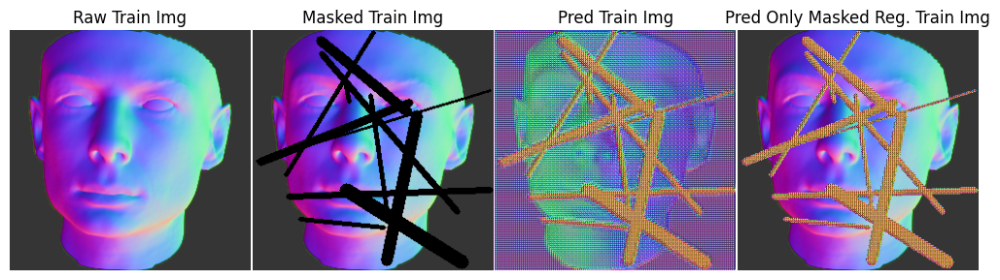

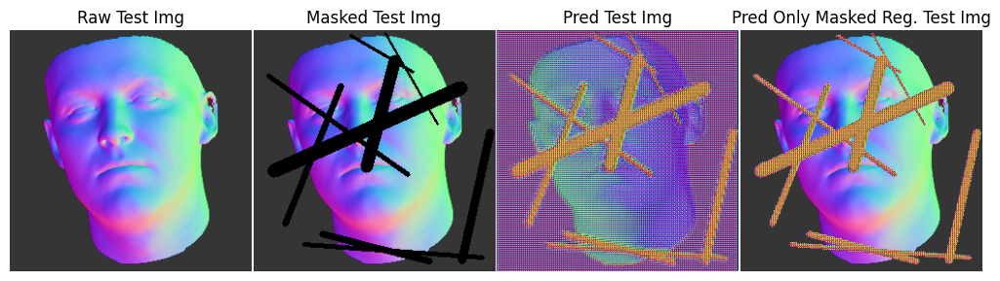

In [25]:
generator_plot_images(generator, 'Train', train_dataset, num = 1)
generator_plot_images(generator, 'Test', test_dataset, num = 1)

In [26]:
print("Generator Loss: ", generator_loss(fake_decision, raw_images_examples,pred_images_examples))
print("Generator SSIM: ", generator_ssim(raw_images_examples,pred_images_examples))
print("Generator PSNR: ", generator_psnr(raw_images_examples,pred_images_examples))

Generator Loss:  tf.Tensor(9.731275, shape=(), dtype=float32)
Generator SSIM:  tf.Tensor(0.020470843, shape=(), dtype=float32)
Generator PSNR:  tf.Tensor(10.849776, shape=(), dtype=float32)


# Training Code Set

### Define Generator and Discriminator training steps for a batch

In [27]:
@tf.function
def train_generator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as gen_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=True)
        train_fake_output = discriminator(train_generated_images, training=False)
        gen_loss = generator_loss(train_fake_output, train_raw_images, train_generated_images)
        gen_ssim = generator_ssim(train_raw_images, train_generated_images)
        gen_psnr = generator_psnr(train_raw_images, train_generated_images)
        
    gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    # generator_optimizer.apply_gradients(zip(gradients, generator.trainable_variables))
    
    return gradients, gen_loss, gen_ssim, gen_psnr

In [28]:
@tf.function
def train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as disc_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=False)
        train_real_output = discriminator(train_raw_images, training=True)
        train_fake_output = discriminator(train_generated_images, training=True)
        
        disc_loss = discriminator_loss(train_real_output, train_fake_output)
        disc_acc = discirminator_acc(train_real_output, train_fake_output)

    gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    # discriminator_optimizer.apply_gradients(zip(gradients, discriminator.trainable_variables))
    
    return gradients, disc_loss, disc_acc

### Define a function to train a list of batches

In [29]:
def train_batches(batches_list):
    gen_loss_total = 0
    gen_ssim_total = 0
    gen_psnr_total = 0
    disc_loss_total = 0
    disc_acc_total = 0

    # cumulative gradient
    accumulated_gen_gradients = [tf.zeros_like(var) for var in generator.trainable_variables]
    accumulated_disc_gradients = [tf.zeros_like(var) for var in discriminator.trainable_variables]
    
    for batch in batches_list:
        train_raw_images = batch
        train_mask_channels = mask_irregular(train_raw_images.shape[0], train_raw_images.shape[1], train_raw_images.shape[2])
        train_masked_images = masked_imgs(train_raw_images, train_mask_channels)
        
        gen_gradients, gen_loss, gen_ssim, gen_psnr = train_generator_step(train_raw_images, train_mask_channels, train_masked_images)
        disc_gradients, disc_loss, disc_acc = train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images)

        # cumulative gradient
        for i in range(len(accumulated_gen_gradients)):
            accumulated_gen_gradients[i] += gen_gradients[i]
        for i in range(len(accumulated_disc_gradients)):
            accumulated_disc_gradients[i] += disc_gradients[i]
        
        gen_loss_total += gen_loss.numpy()
        gen_ssim_total += gen_ssim.numpy()
        gen_psnr_total += gen_psnr.numpy()
        disc_loss_total += disc_loss.numpy()
        disc_acc_total += disc_acc.numpy()

    # Applying cumulative gradients
    generator_optimizer.apply_gradients(zip(accumulated_gen_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(accumulated_disc_gradients, discriminator.trainable_variables))
    
    num_batches = len(batches_list)
    return (gen_loss_total / num_batches, gen_ssim_total / num_batches, gen_psnr_total / num_batches,
            disc_loss_total / num_batches, disc_acc_total / num_batches)

### Evaluate the function for the dataset

In [30]:
# Evaluating data from a single batch
@tf.function
def evaluate_batch(raw_images, mask_channels):
    masked_images = masked_imgs(raw_images, mask_channels)
    generated_images = generator([masked_images, mask_channels], training=False)
    real_output = discriminator(raw_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    return {
        'gen_loss': generator_loss(fake_output, raw_images, generated_images),
        'gen_ssim': generator_ssim(raw_images, generated_images),
        'gen_psnr': generator_psnr(raw_images, generated_images),
        'disc_loss': discriminator_loss(real_output, fake_output),
        'disc_acc': discirminator_acc(real_output, fake_output)
    }

# Overall assessment function
def assessment(dataset):
    metrics_sums = {
        'gen_loss': 0,
        'gen_ssim': 0,
        'gen_psnr': 0,
        'disc_loss': 0,
        'disc_acc': 0
    }
    batch_count = 0
    
    for images_batch in dataset:
        batch_metrics = evaluate_batch(images_batch, mask_irregular(images_batch.shape[0], images_batch.shape[1], images_batch.shape[2]))
        batch_count += 1

        for key in metrics_sums:
            metrics_sums[key] += batch_metrics[key].numpy()

    return {key: total / batch_count for key, total in metrics_sums.items()}

### Processing batch data

In [31]:
def process_batches(dataset, batches_list_num):
    train_dataset_batches_list = []
    epoch_metrics = {
        "train_gen_loss": [], "train_gen_ssim": [], "train_gen_psnr": [], 
        "train_disc_loss": [], "train_disc_acc": []
    }

    for i, images_batch in enumerate(dataset):
        train_dataset_batches_list.append(images_batch)
        if (i + 1) % batches_list_num == 0:
            batch_metrics = train_batches(train_dataset_batches_list)
            train_dataset_batches_list = []
            for key, value in zip(epoch_metrics.keys(), batch_metrics):
                    epoch_metrics[key].append(value)

    # Check for unprocessed batch
    if train_dataset_batches_list:
        batch_metrics = train_batches(train_dataset_batches_list)
        train_dataset_batches_list = []
        for key, value in zip(epoch_metrics.keys(), batch_metrics):
                epoch_metrics[key].append(value)

    return epoch_metrics

### Record training information to CSV file

In [32]:
def record_training_info(log_file, current_epoch, metrics_lists, elapsed_time):
    with open(log_file, "a", newline='') as file:
        writer = csv.writer(file)
        if os.stat(log_file).st_size == 0:
            writer.writerow(["Epoch"] + list(metrics_lists.keys()) + ["Elapsed Time (Seconds)"])

        writer.writerow([current_epoch] + [sum(metrics) / len(metrics) for metrics in metrics_lists.values()] + [elapsed_time])

### Print training information

In [33]:
def print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time):
    print(f"Epoch {current_epoch}/{total_epochs}  "
          f"Train[G_Loss:{metrics_lists['train_gen_loss'][-1]:.5f} SSIM:{metrics_lists['train_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['train_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['train_disc_loss'][-1]:.5f} {metrics_lists['train_disc_acc'][-1] * 100:.3f}%]  "
          f"Test[G_Loss:{metrics_lists['test_gen_loss'][-1]:.5f} SSIM:{metrics_lists['test_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['test_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['test_disc_loss'][-1]:.5f} {metrics_lists['test_disc_acc'][-1] * 100:.3f}%] "
          f"- {elapsed_time:.0f}s")

### Charting metrics

In [34]:
def plot_metrics(metrics_lists):
    start_epoch = 1
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_ssim'], 
                     metrics_lists['test_gen_loss'], metrics_lists['test_gen_ssim'], 
                     'Generator Loss and SSIM', 'SSIM', start=start_epoch)
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_psnr'], 
                     metrics_lists['test_gen_loss'], metrics_lists['test_gen_psnr'], 
                     'Generator Loss and PSNR', 'PSNR', start=start_epoch)
    plot_loss_metric(metrics_lists['train_disc_loss'], metrics_lists['train_disc_acc'], 
                     metrics_lists['test_disc_loss'], metrics_lists['test_disc_acc'], 
                     'Discriminator Loss and Accuracy', 'Accuracy', start=start_epoch)

In [35]:
def load_metrics_from_csv(log_file):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                for key in metrics_lists.keys():
                    metrics_lists[key].append(float(row[key]))

    return metrics_lists

### Save checkpoints

In [36]:
checkpoint_dir = './training_checkpoints'
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)
checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=1)

### Restore the latest saved checkpoint (if exist)

In [37]:
checkpoint.restore(checkpoint_manager.latest_checkpoint)

### Restoring Training Logs from Previous Sessions

In [38]:
def display_saved_images(epoch, image_path='./saved_images'):
    train_image_path = os.path.join(image_path, f'Train_epoch_{epoch}.png')
    test_image_path = os.path.join(image_path, f'Test_epoch_{epoch}.png')

    if os.path.exists(train_image_path):
        train_image = mpimg.imread(train_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(train_image)
        plt.axis('off')
        plt.show()

    if os.path.exists(test_image_path):
        test_image = mpimg.imread(test_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(test_image)
        plt.axis('off')
        plt.show()

In [39]:
def load_metrics_until_epoch(log_file, epoch):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                if int(row['Epoch']) <= epoch:
                    for key in metrics_lists.keys():
                        metrics_lists[key].append(float(row[key]))

    return metrics_lists

In [40]:
def read_last_epoch(log_file, total_epochs, epoch_break):
    last_valid_epoch = 0
    cleaned_data = []

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            rows = list(csv.reader(file))
            header = rows[0]
            data_rows = rows[1:]

            # Find a multiple of the last epoch_break
            for row in reversed(data_rows):
                epoch = int(row[0])
                if epoch % epoch_break == 0:
                    last_valid_epoch = epoch
                    cleaned_data = data_rows[:data_rows.index(row) + 1]
                    break

            #  If a matching epoch is found, rewrite the file
            if cleaned_data:
                with open(log_file, "w", newline='') as file:
                    writer = csv.writer(file)
                    writer.writerow(header)
                    writer.writerows(cleaned_data)

            # Reprint previous training information
            for data in cleaned_data:
                current_epoch = int(data[0])
                elapsed_time = float(data[-1])
                metrics_lists = {
                    'train_gen_loss': [float(data[1])],
                    'train_gen_ssim': [float(data[2])],
                    'train_gen_psnr': [float(data[3])],
                    'train_disc_loss': [float(data[4])],
                    'train_disc_acc': [float(data[5])],
                    'test_gen_loss': [float(data[6])],
                    'test_gen_ssim': [float(data[7])],
                    'test_gen_psnr': [float(data[8])],
                    'test_disc_loss': [float(data[9])],
                    'test_disc_acc': [float(data[10])]
                }
                print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time)

                if current_epoch % epoch_break == 0:
                    display_saved_images(current_epoch)
                    plot_metrics(load_metrics_until_epoch(log_file, current_epoch))

    return last_valid_epoch

### Training

In [41]:
class EarlyStopping:
    def __init__(self, monitor='val_loss', patience=10, verbose=False):
        self.monitor = monitor
        self.patience = patience
        self.verbose = verbose
        self.best_val = float('inf')
        self.wait = 0
        self.stopped_epoch = 0
        self.stop_training = False

    def on_epoch_end(self, epoch, current_val):
        if current_val < self.best_val:
            self.best_val = current_val
            self.wait = 0
        else:
            self.wait += 1
            if self.wait >= self.patience:
                self.stopped_epoch = epoch
                self.stop_training = True
                if self.verbose:
                    print(f"EarlyStopping: Stop training at epoch {epoch + 1}")


In [42]:
def train(train_dataset, epochs, epoch_break, batches_list_num):
    
    log_dir = './saved_logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, "GAN_training_results.csv")
    
    # Read the last completed epoch
    start_epoch = read_last_epoch(log_file, epochs, epoch_break)
    
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'test_gen_loss': [], 'test_gen_ssim': [], 'test_gen_psnr': [],
        'test_disc_loss': [], 'test_disc_acc': []
    }

    early_stopper = EarlyStopping(monitor='test_gen_loss', patience=10, verbose=True)
        
    for epoch in range(start_epoch, epochs):
        start_time = time.time()

        # # For Train
        epoch_metrics = process_batches(train_dataset, batches_list_num)
        for key in epoch_metrics.keys():
            metrics_lists[key].append(sum(epoch_metrics[key]) / len(epoch_metrics[key]))
                    
        # For Test
        test_metrics = assessment(test_dataset)
        for key, value in test_metrics.items():
            metrics_lists['test_' + key].append(value)
        
        # Save Training Information
        current_epoch = epoch + 1
        elapsed_time = time.time() - start_time
        record_training_info(log_file, current_epoch, metrics_lists, elapsed_time)

        # Print Training Information
        print_training_info(current_epoch, epochs, metrics_lists, elapsed_time)
        
        # Epoch output results with set intervals
        if (epoch + 1) % epoch_break == 0:
    
            print('Saving checkpoint...')
            checkpoint_manager.save()
            print('Save completed')
            
            generator_plot_images(generator, 'Train', train_dataset, epoch=current_epoch, save_images=True)
            generator_plot_images(generator, 'Test', test_dataset, epoch=current_epoch, save_images=True)

            plot_metrics(load_metrics_from_csv(log_file))

            current_val = metrics_lists['test_gen_loss'][-1]
            early_stopper.on_epoch_end(epoch, current_val)
            if early_stopper.stop_training:
                print(f"Early stopping triggered at epoch {epoch + 1}")
                break


Epoch 1/300  Train[G_Loss:5.52943 SSIM:8.29% PSNR:11.29 Disc:0.22779 94.074%]  Test[G_Loss:7.81633 SSIM:8.98% PSNR:11.20 Disc:0.52359 97.619%] - 64s
Epoch 2/300  Train[G_Loss:3.25637 SSIM:15.21% PSNR:11.61 Disc:0.01848 99.741%]  Test[G_Loss:11.06148 SSIM:7.14% PSNR:11.10 Disc:0.77716 88.571%] - 51s
Epoch 3/300  Train[G_Loss:3.08448 SSIM:13.70% PSNR:11.55 Disc:0.04452 99.444%]  Test[G_Loss:10.83400 SSIM:7.52% PSNR:11.22 Disc:0.91735 92.857%] - 51s
Epoch 4/300  Train[G_Loss:2.60667 SSIM:12.32% PSNR:11.52 Disc:0.03272 99.333%]  Test[G_Loss:8.47722 SSIM:9.78% PSNR:11.40 Disc:0.90618 96.667%] - 52s
Epoch 5/300  Train[G_Loss:2.42881 SSIM:12.47% PSNR:11.53 Disc:0.04691 99.148%]  Test[G_Loss:4.99304 SSIM:11.46% PSNR:11.50 Disc:5.12561 73.810%] - 52s
Epoch 6/300  Train[G_Loss:2.16116 SSIM:12.52% PSNR:11.54 Disc:0.04437 99.222%]  Test[G_Loss:4.68849 SSIM:13.33% PSNR:11.58 Disc:9.52876 53.333%] - 52s
Epoch 7/300  Train[G_Loss:2.10921 SSIM:12.54% PSNR:11.55 Disc:0.01714 99.741%]  Test[G_Loss:3.438

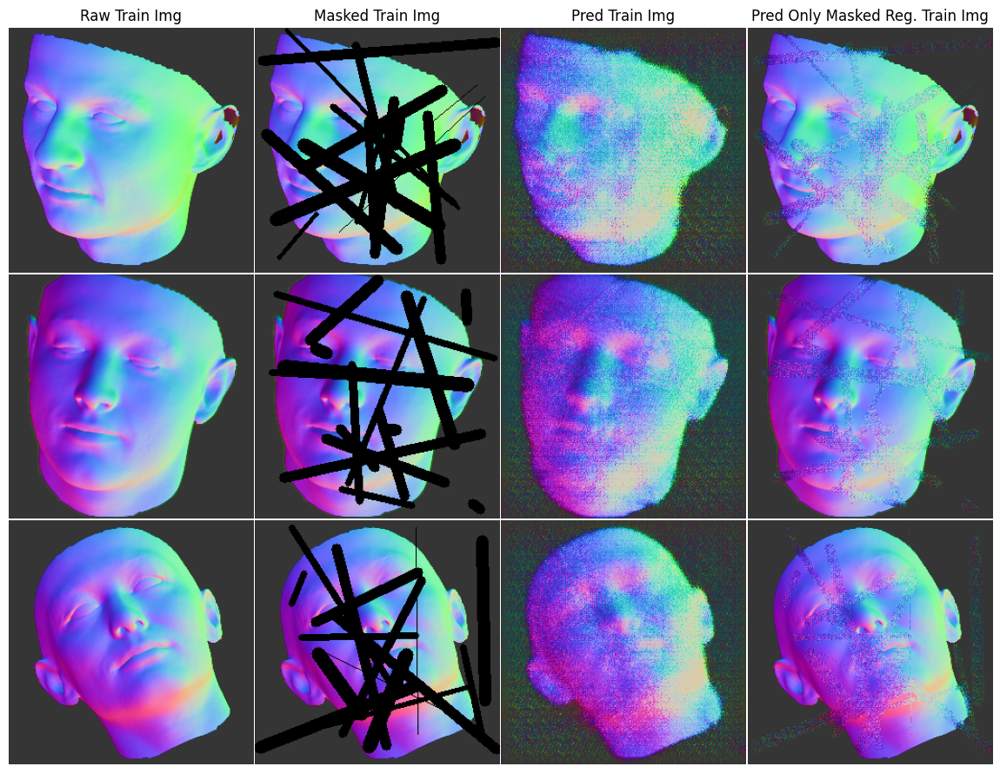

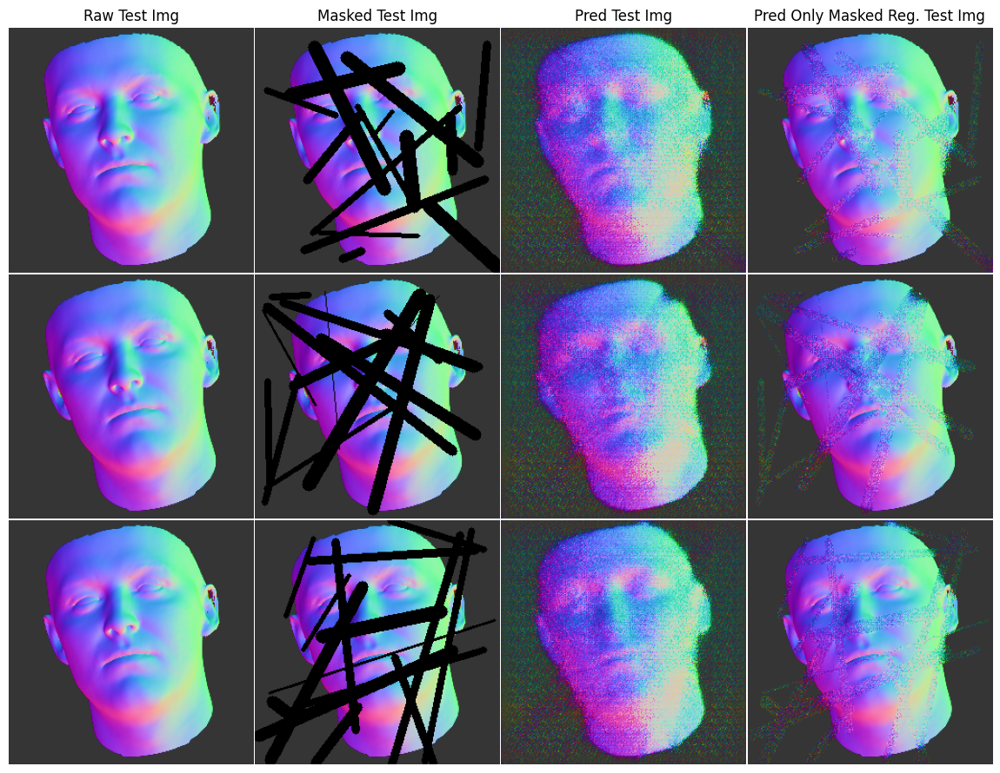

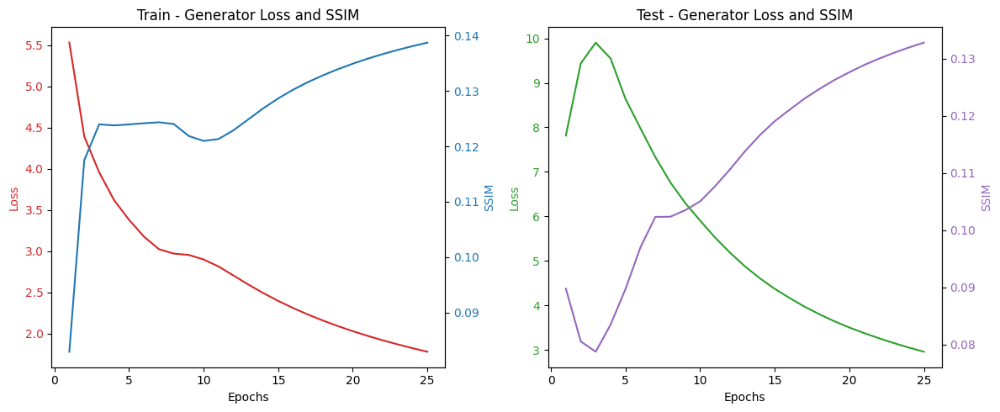

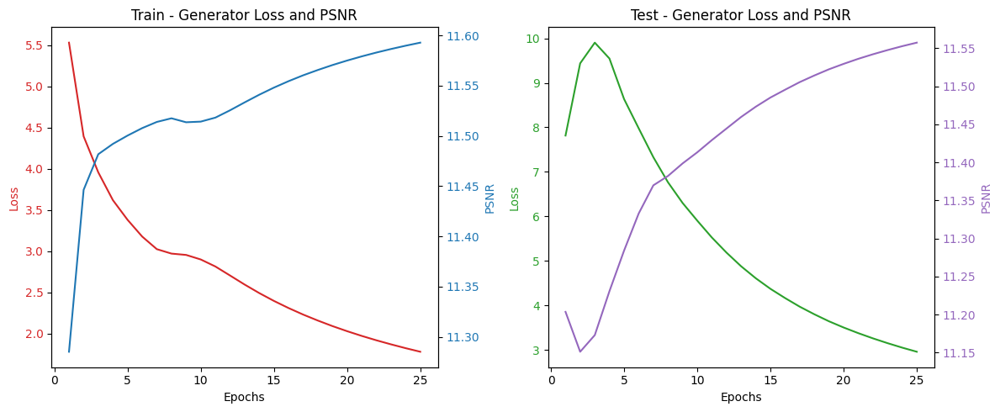

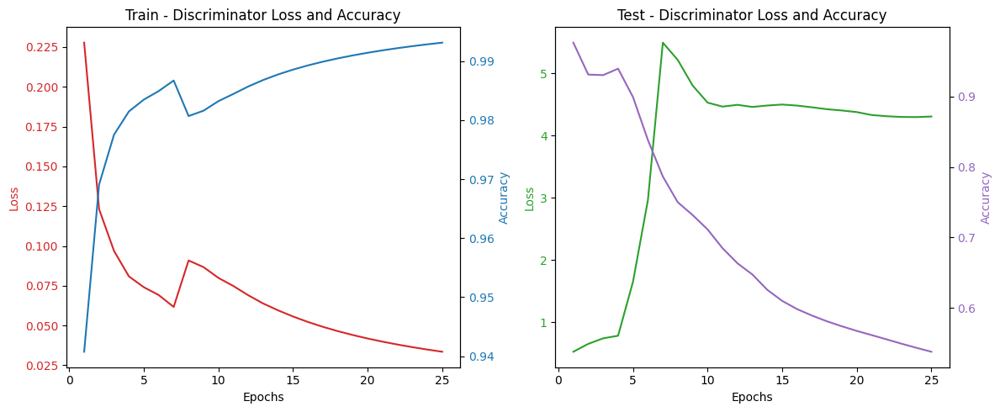

Epoch 26/300  Train[G_Loss:0.72222 SSIM:15.37% PSNR:11.67 Disc:0.00015 100.000%]  Test[G_Loss:0.69845 SSIM:15.29% PSNR:11.67 Disc:4.54585 40.476%] - 52s
Epoch 27/300  Train[G_Loss:0.70552 SSIM:15.37% PSNR:11.67 Disc:0.00011 100.000%]  Test[G_Loss:0.69910 SSIM:15.29% PSNR:11.67 Disc:4.42561 40.476%] - 52s
Epoch 28/300  Train[G_Loss:0.68054 SSIM:15.39% PSNR:11.67 Disc:0.00014 100.000%]  Test[G_Loss:0.68060 SSIM:15.25% PSNR:11.67 Disc:4.56255 40.952%] - 52s
Epoch 29/300  Train[G_Loss:0.67948 SSIM:15.34% PSNR:11.67 Disc:0.00008 100.000%]  Test[G_Loss:0.64278 SSIM:15.29% PSNR:11.67 Disc:4.44046 41.429%] - 52s
Epoch 30/300  Train[G_Loss:0.64042 SSIM:15.40% PSNR:11.67 Disc:0.00014 100.000%]  Test[G_Loss:0.62669 SSIM:15.27% PSNR:11.67 Disc:4.58261 41.429%] - 52s
Epoch 31/300  Train[G_Loss:0.64095 SSIM:15.34% PSNR:11.67 Disc:0.00009 100.000%]  Test[G_Loss:0.65372 SSIM:15.27% PSNR:11.67 Disc:4.21206 41.429%] - 52s
Epoch 32/300  Train[G_Loss:0.63688 SSIM:15.32% PSNR:11.67 Disc:0.00008 100.000%]  

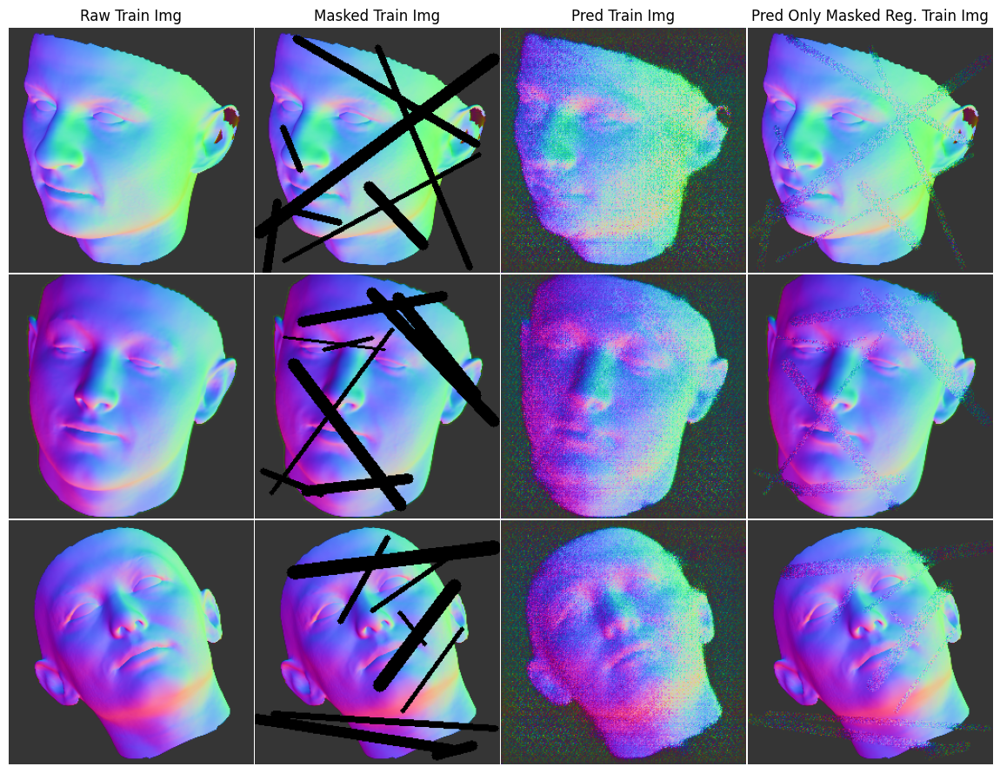

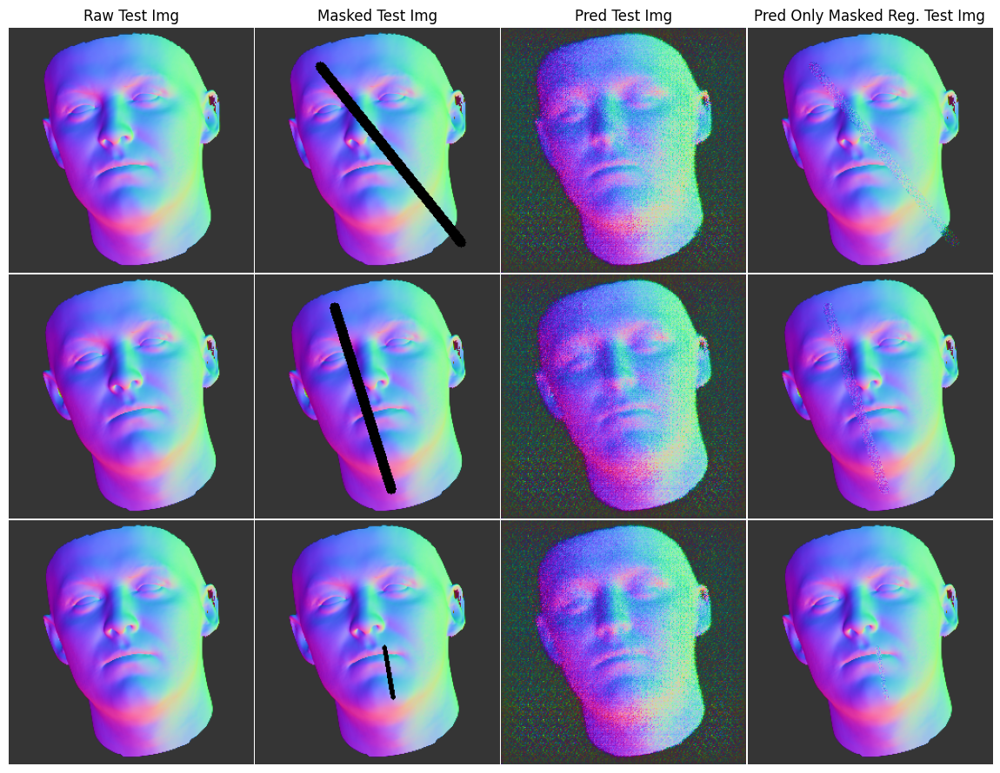

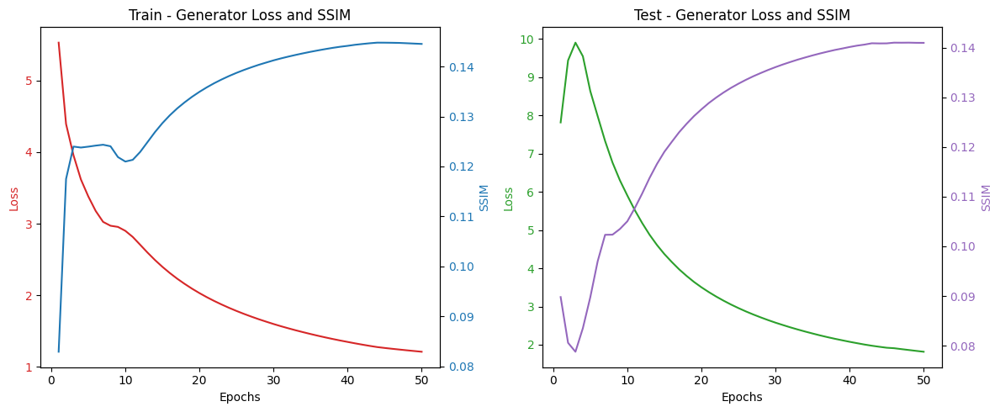

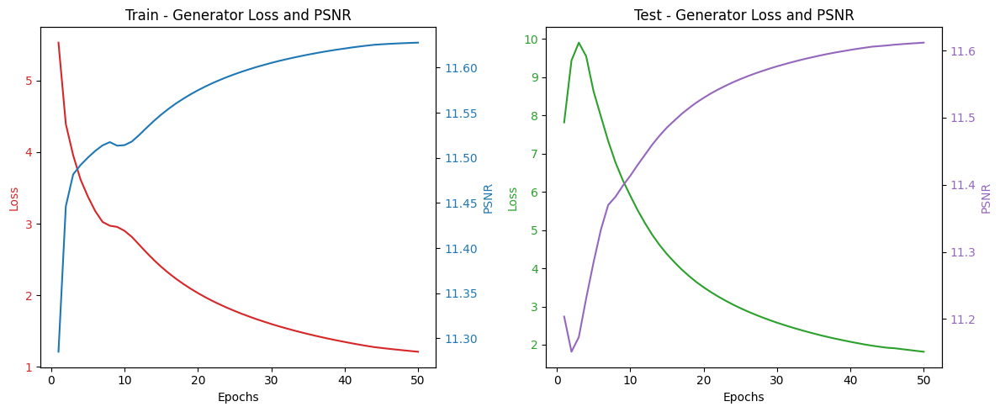

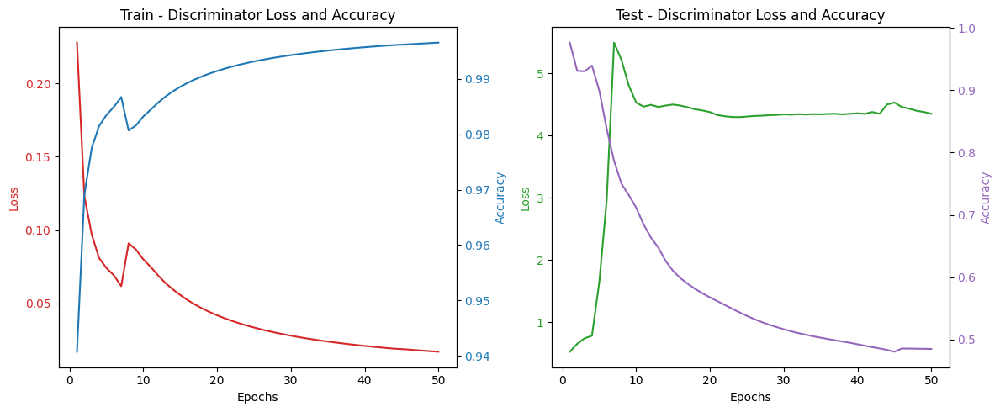

Epoch 51/300  Train[G_Loss:0.70764 SSIM:14.09% PSNR:11.64 Disc:0.00000 100.000%]  Test[G_Loss:0.69411 SSIM:13.86% PSNR:11.64 Disc:4.23874 47.619%] - 52s
Epoch 52/300  Train[G_Loss:0.69564 SSIM:14.08% PSNR:11.64 Disc:0.00000 100.000%]  Test[G_Loss:0.71385 SSIM:14.06% PSNR:11.65 Disc:3.06791 47.619%] - 52s
Epoch 53/300  Train[G_Loss:0.67955 SSIM:14.07% PSNR:11.64 Disc:0.00000 100.000%]  Test[G_Loss:0.65318 SSIM:13.86% PSNR:11.64 Disc:4.18682 47.619%] - 52s
Epoch 54/300  Train[G_Loss:0.64717 SSIM:14.10% PSNR:11.64 Disc:0.00000 100.000%]  Test[G_Loss:0.65877 SSIM:13.95% PSNR:11.64 Disc:3.58614 47.619%] - 52s
Epoch 55/300  Train[G_Loss:0.63759 SSIM:14.07% PSNR:11.64 Disc:0.00000 100.000%]  Test[G_Loss:0.64490 SSIM:13.81% PSNR:11.64 Disc:4.27393 47.619%] - 52s
Epoch 56/300  Train[G_Loss:0.63014 SSIM:14.04% PSNR:11.64 Disc:0.00000 100.000%]  Test[G_Loss:0.60494 SSIM:14.00% PSNR:11.65 Disc:3.45278 47.619%] - 52s
Epoch 57/300  Train[G_Loss:0.62777 SSIM:14.01% PSNR:11.64 Disc:0.00000 100.000%]  

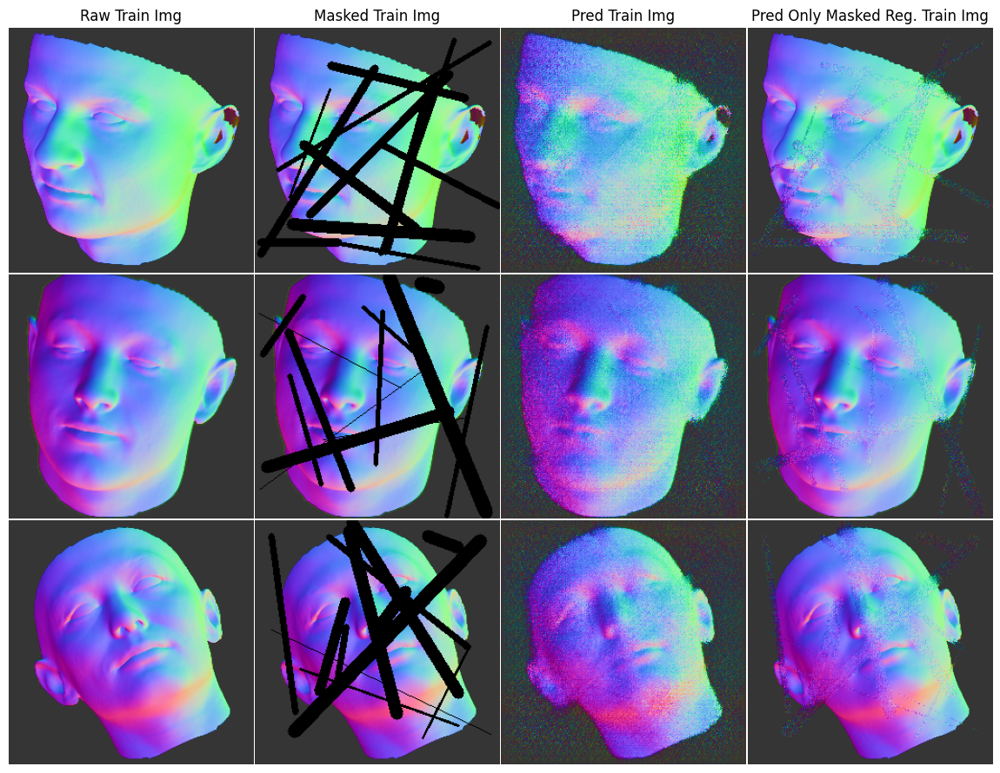

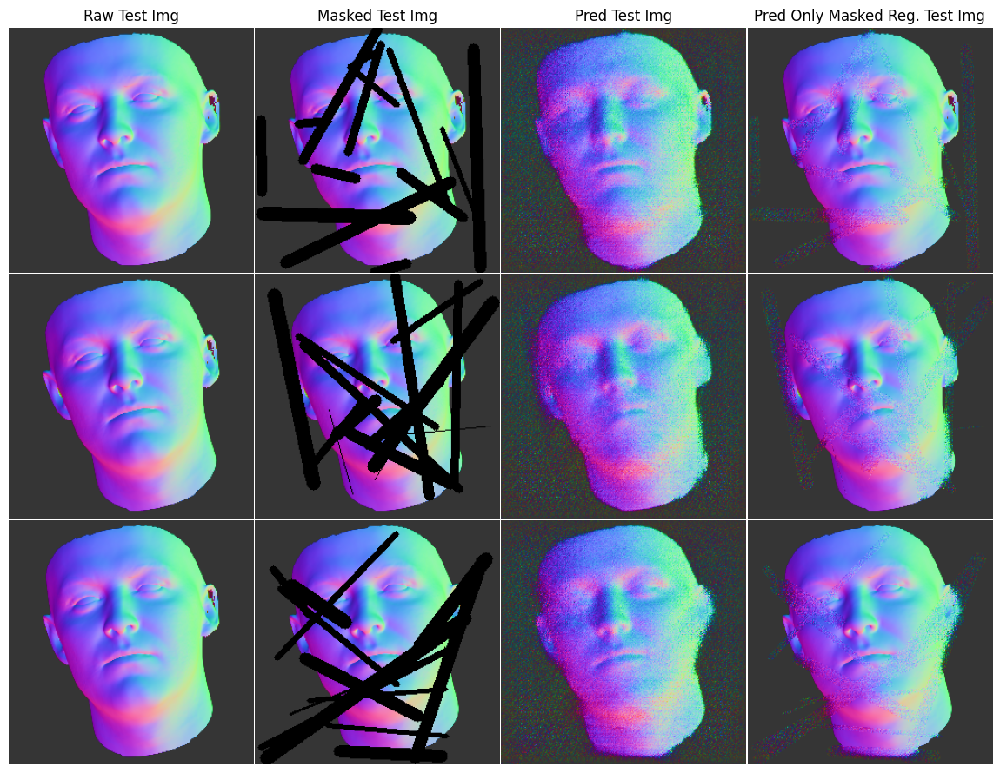

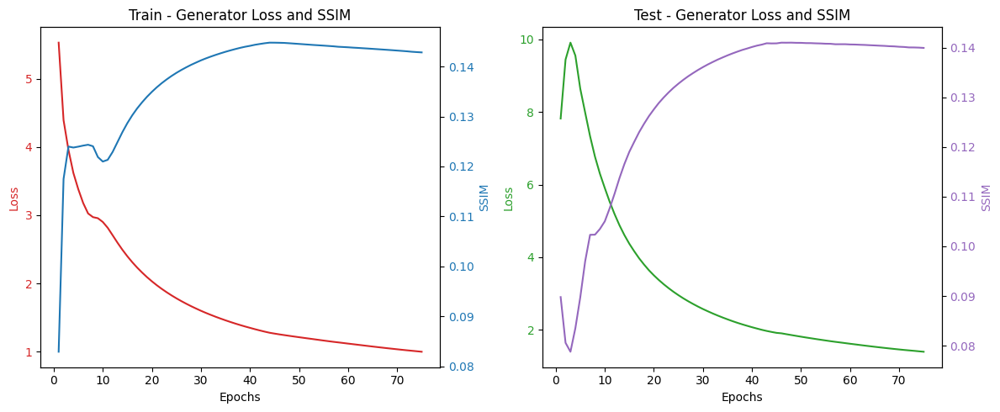

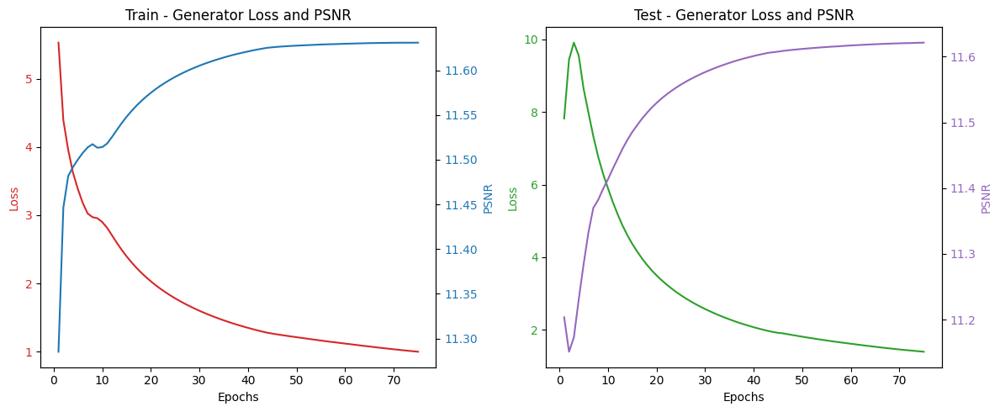

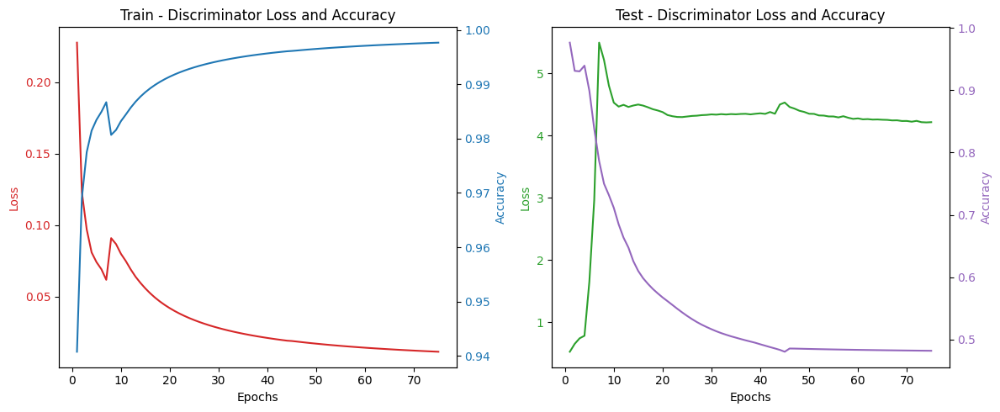

Epoch 76/300  Train[G_Loss:0.46220 SSIM:13.71% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:0.40945 SSIM:13.62% PSNR:11.64 Disc:4.06173 47.619%] - 52s
Epoch 77/300  Train[G_Loss:0.44232 SSIM:13.73% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:0.41537 SSIM:13.49% PSNR:11.63 Disc:4.74121 47.619%] - 52s
Epoch 78/300  Train[G_Loss:0.43478 SSIM:13.67% PSNR:11.63 Disc:0.00001 100.000%]  Test[G_Loss:0.40533 SSIM:13.54% PSNR:11.63 Disc:4.42243 47.619%] - 52s
Epoch 79/300  Train[G_Loss:0.43392 SSIM:13.62% PSNR:11.63 Disc:0.00000 100.000%]  Test[G_Loss:0.39597 SSIM:13.47% PSNR:11.63 Disc:4.54821 47.619%] - 52s
Epoch 80/300  Train[G_Loss:0.42994 SSIM:13.60% PSNR:11.63 Disc:0.00000 100.000%]  Test[G_Loss:0.43358 SSIM:13.48% PSNR:11.63 Disc:4.18753 47.619%] - 52s
Epoch 81/300  Train[G_Loss:0.42824 SSIM:13.59% PSNR:11.63 Disc:0.00000 100.000%]  Test[G_Loss:0.40343 SSIM:13.41% PSNR:11.63 Disc:4.34894 47.619%] - 52s
Epoch 82/300  Train[G_Loss:0.43050 SSIM:13.54% PSNR:11.63 Disc:0.00001 100.000%]  

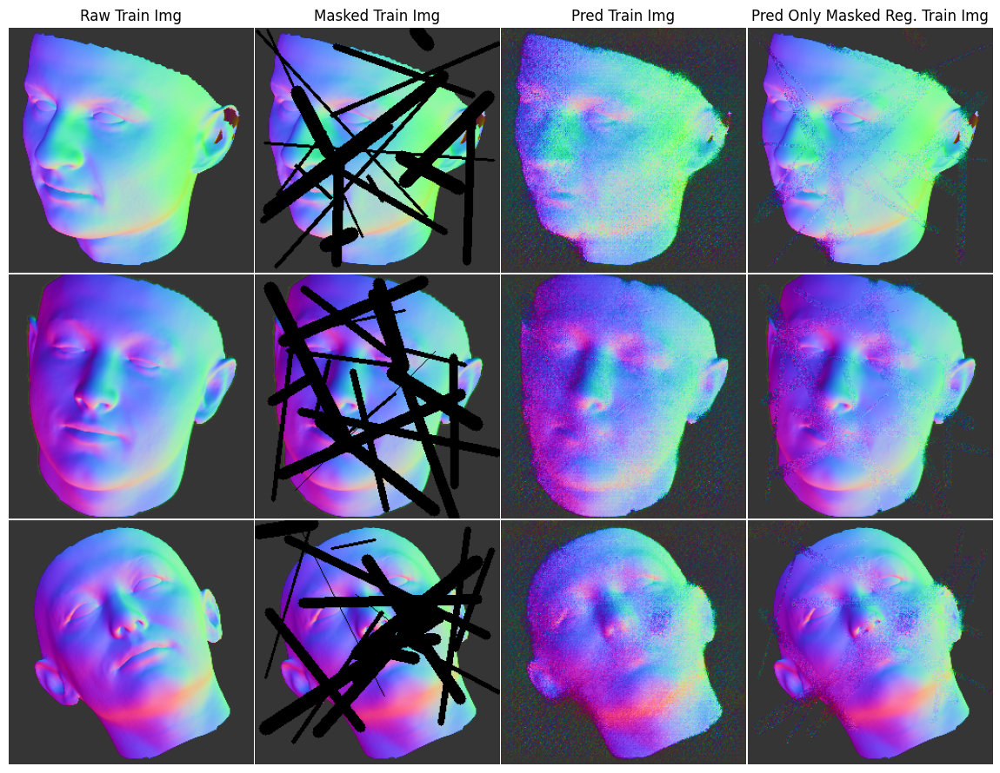

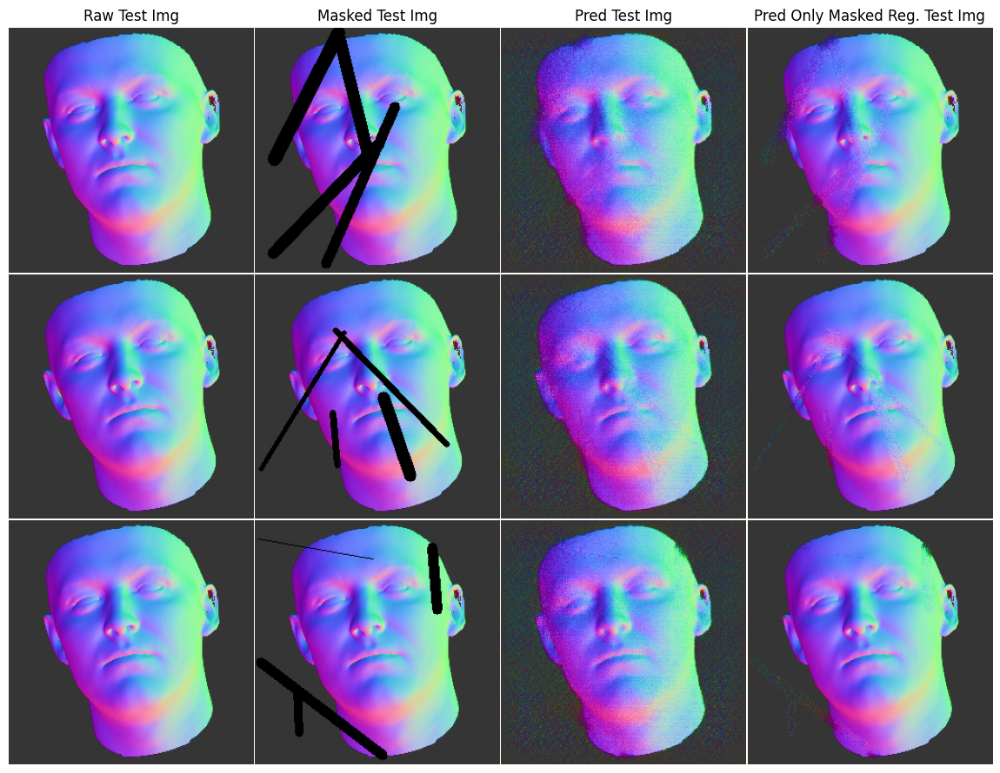

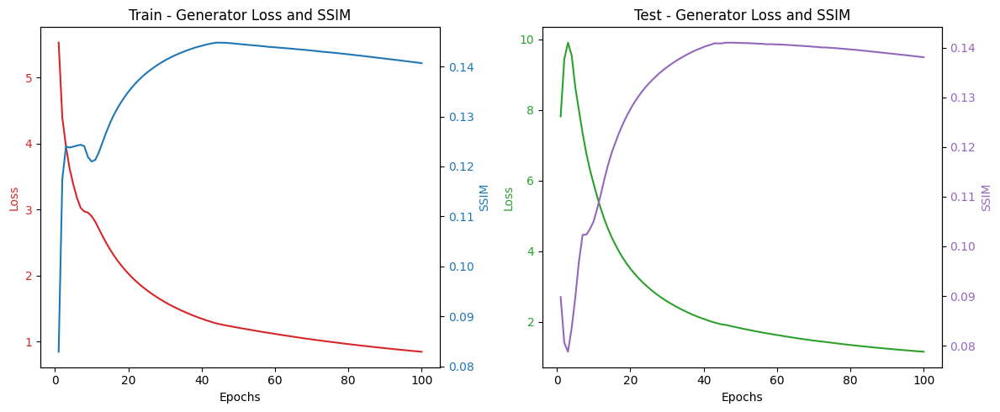

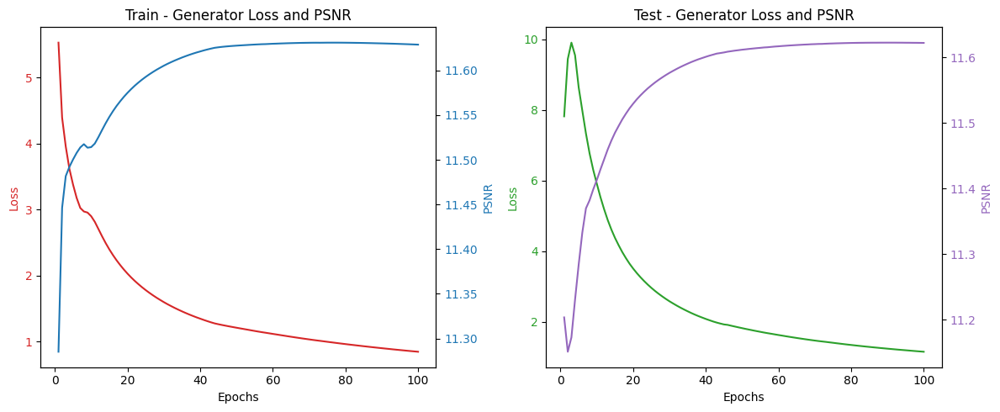

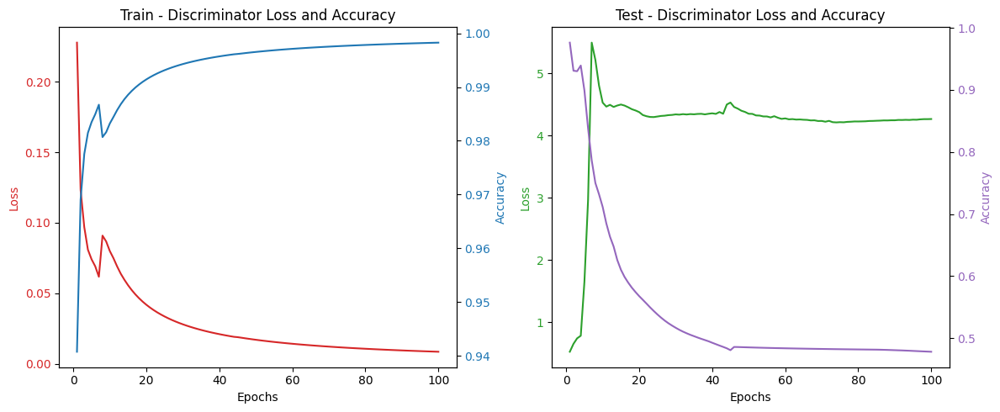

Epoch 101/300  Train[G_Loss:0.34601 SSIM:13.10% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:0.33512 SSIM:12.93% PSNR:11.61 Disc:4.60525 45.238%] - 52s
Epoch 102/300  Train[G_Loss:0.34183 SSIM:13.08% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:0.31446 SSIM:12.85% PSNR:11.61 Disc:4.49660 45.238%] - 53s
Epoch 103/300  Train[G_Loss:0.33989 SSIM:13.06% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:0.33159 SSIM:12.84% PSNR:11.61 Disc:4.56648 45.238%] - 52s
Epoch 104/300  Train[G_Loss:0.33338 SSIM:13.05% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:0.34632 SSIM:12.91% PSNR:11.61 Disc:4.43798 45.238%] - 52s
Epoch 105/300  Train[G_Loss:0.32733 SSIM:13.02% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:0.36174 SSIM:12.90% PSNR:11.61 Disc:4.22670 45.238%] - 52s
Epoch 106/300  Train[G_Loss:0.33378 SSIM:13.02% PSNR:11.61 Disc:0.00000 100.000%]  Test[G_Loss:0.32442 SSIM:12.80% PSNR:11.61 Disc:4.71227 45.238%] - 52s
Epoch 107/300  Train[G_Loss:0.31943 SSIM:13.02% PSNR:11.61 Disc:0.00001 100.

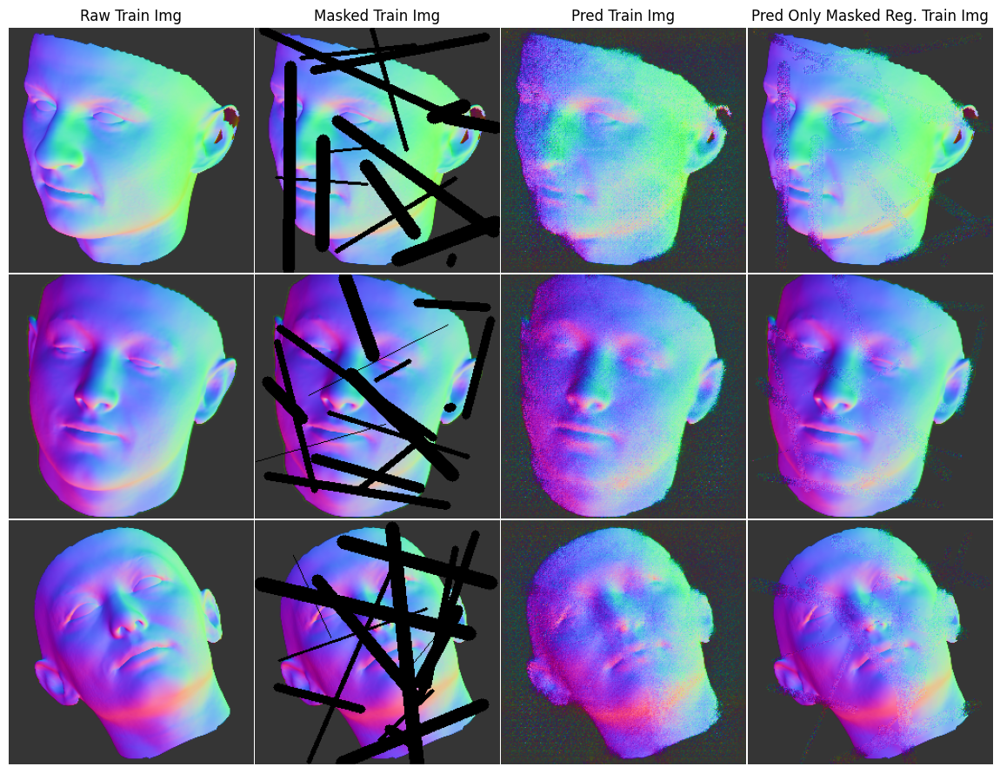

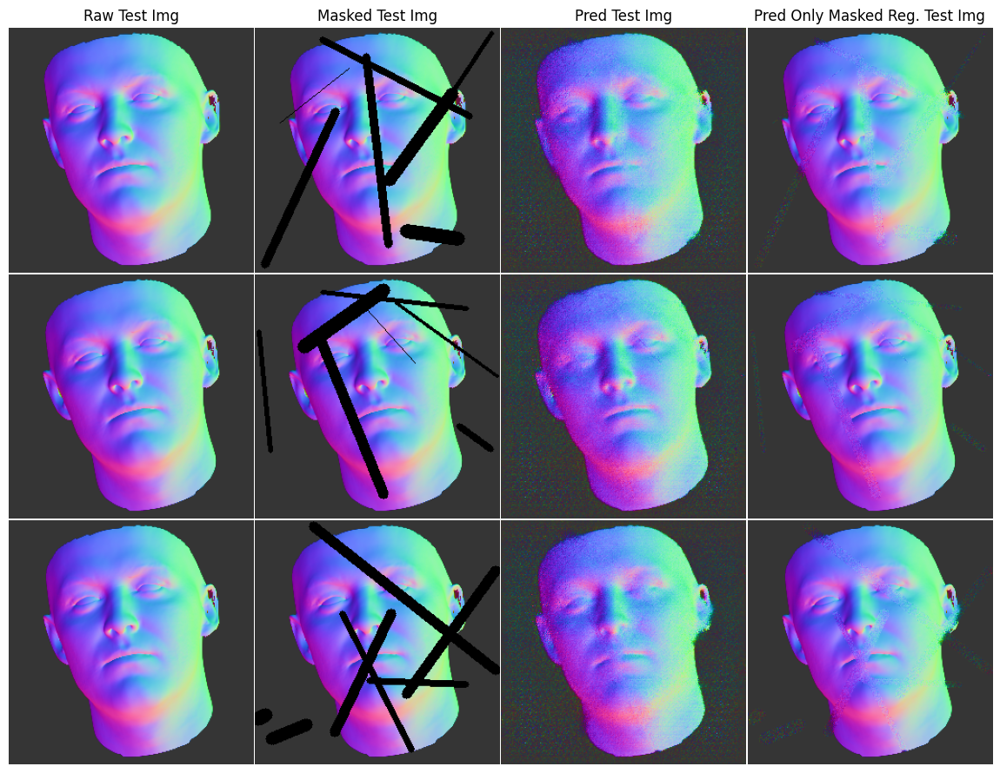

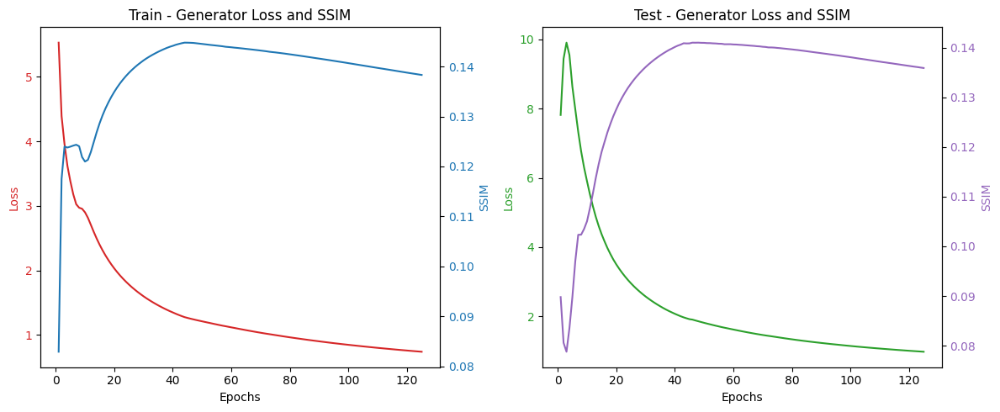

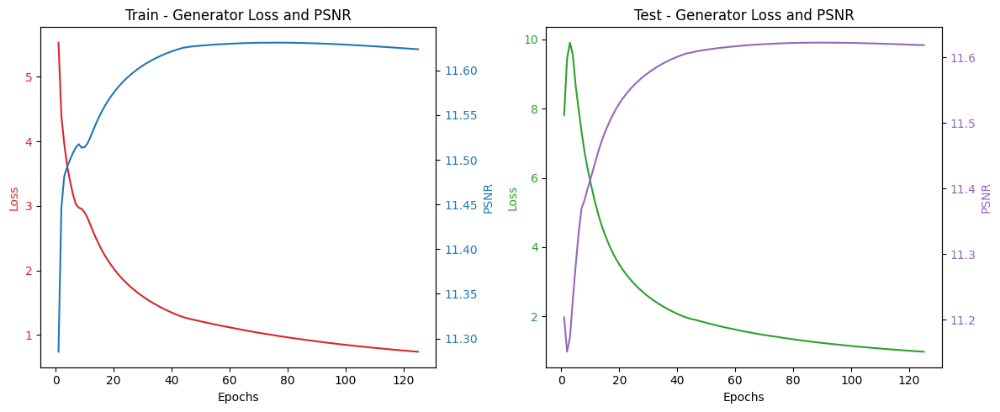

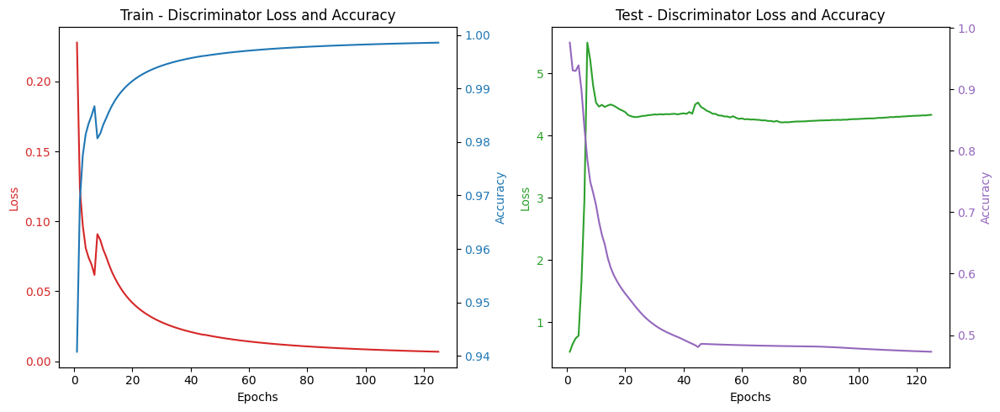

Epoch 126/300  Train[G_Loss:0.28935 SSIM:12.65% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:0.27215 SSIM:12.47% PSNR:11.60 Disc:4.99276 45.238%] - 52s
Epoch 127/300  Train[G_Loss:0.27331 SSIM:12.69% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:0.25057 SSIM:12.44% PSNR:11.60 Disc:4.82126 45.238%] - 52s
Epoch 128/300  Train[G_Loss:0.27729 SSIM:12.66% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:0.27358 SSIM:12.52% PSNR:11.60 Disc:4.97355 45.238%] - 53s
Epoch 129/300  Train[G_Loss:0.28832 SSIM:12.60% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:0.30562 SSIM:12.63% PSNR:11.60 Disc:3.99301 45.238%] - 53s
Epoch 130/300  Train[G_Loss:0.28689 SSIM:12.63% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:0.27061 SSIM:12.45% PSNR:11.60 Disc:4.95914 45.238%] - 52s
Epoch 131/300  Train[G_Loss:0.27741 SSIM:12.64% PSNR:11.59 Disc:0.00000 100.000%]  Test[G_Loss:0.28397 SSIM:12.47% PSNR:11.60 Disc:4.70422 45.238%] - 52s
Epoch 132/300  Train[G_Loss:0.27381 SSIM:12.58% PSNR:11.59 Disc:0.00000 100.

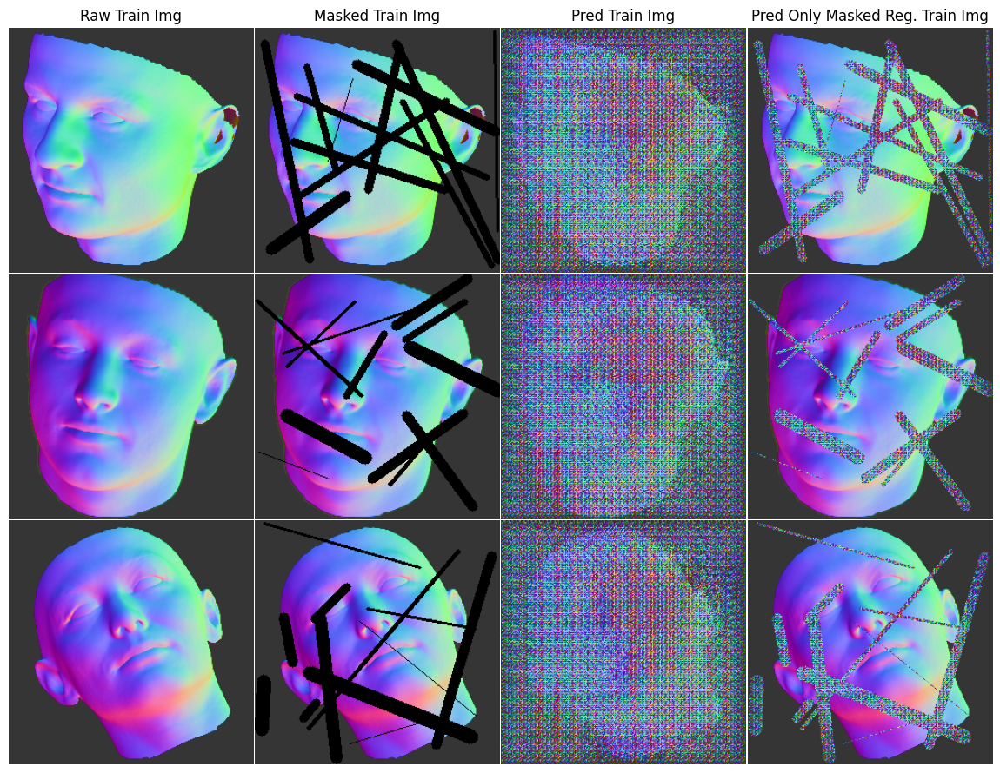

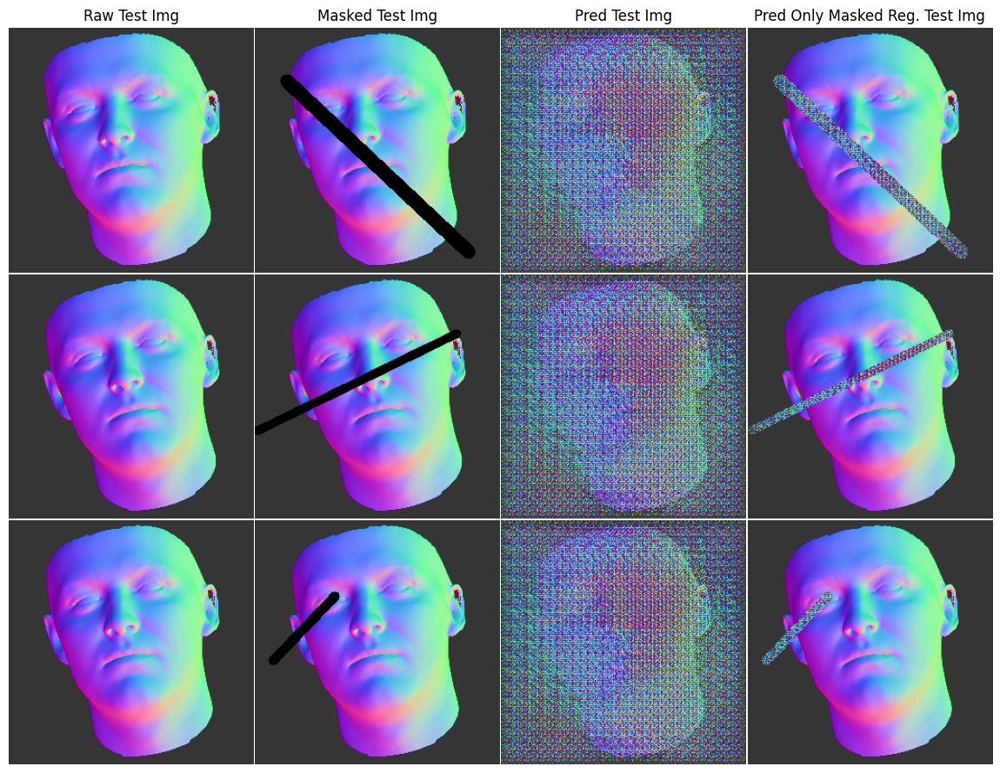

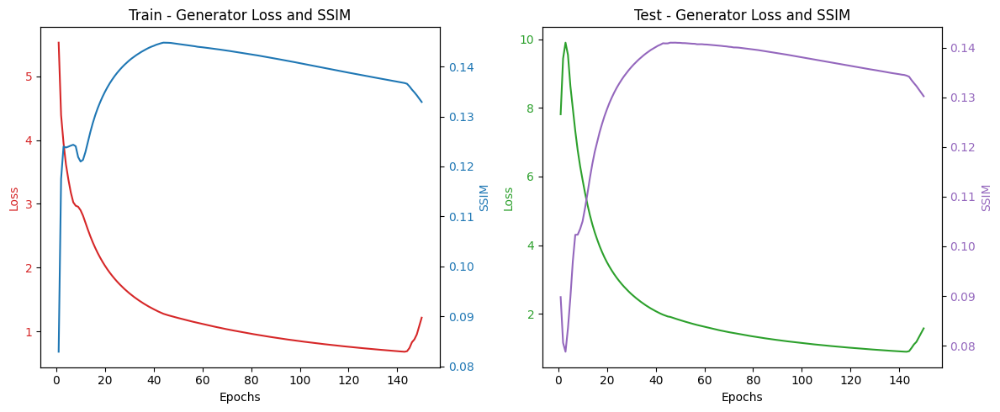

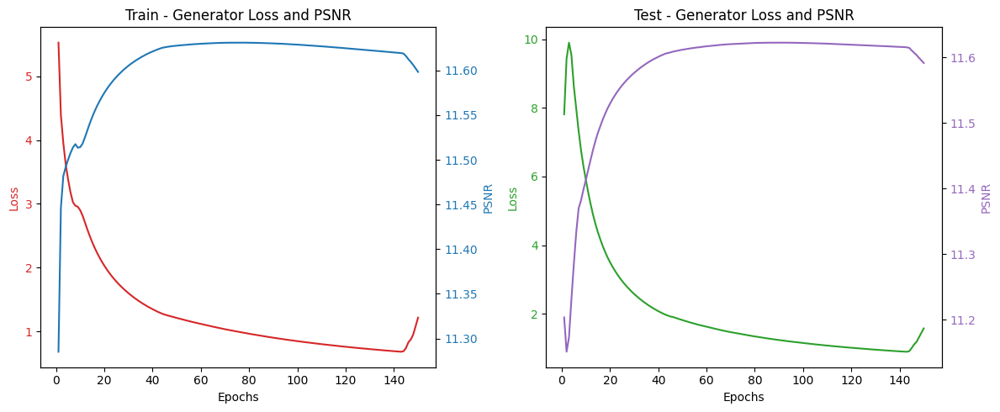

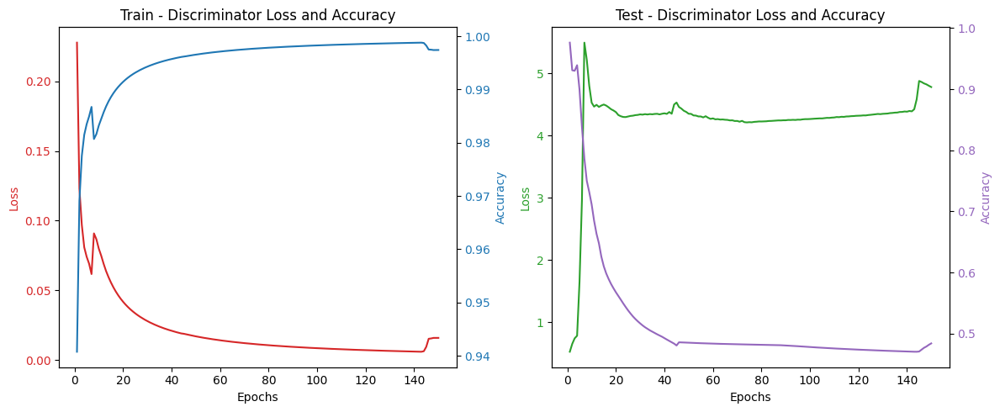

Epoch 151/300  Train[G_Loss:21.70090 SSIM:3.26% PSNR:11.02 Disc:0.00156 100.000%]  Test[G_Loss:21.60381 SSIM:3.22% PSNR:11.02 Disc:2.15201 75.714%] - 52s
Epoch 152/300  Train[G_Loss:20.79048 SSIM:3.24% PSNR:11.01 Disc:0.00755 99.926%]  Test[G_Loss:20.53364 SSIM:3.15% PSNR:11.01 Disc:3.16854 66.667%] - 53s
Epoch 153/300  Train[G_Loss:20.09862 SSIM:3.16% PSNR:11.00 Disc:0.00278 100.000%]  Test[G_Loss:19.96333 SSIM:3.22% PSNR:11.01 Disc:4.41329 59.524%] - 53s
Epoch 154/300  Train[G_Loss:19.74994 SSIM:3.18% PSNR:11.00 Disc:0.00054 100.000%]  Test[G_Loss:19.72200 SSIM:3.05% PSNR:11.00 Disc:5.10083 55.714%] - 53s
Epoch 155/300  Train[G_Loss:19.36696 SSIM:3.13% PSNR:11.00 Disc:0.00045 100.000%]  Test[G_Loss:19.18974 SSIM:3.10% PSNR:11.00 Disc:5.38755 53.810%] - 52s
Epoch 156/300  Train[G_Loss:18.88880 SSIM:3.09% PSNR:10.99 Disc:0.00071 100.000%]  Test[G_Loss:18.78460 SSIM:2.86% PSNR:10.98 Disc:5.45681 53.333%] - 52s
Epoch 157/300  Train[G_Loss:18.48048 SSIM:3.04% PSNR:10.99 Disc:0.00130 100.0

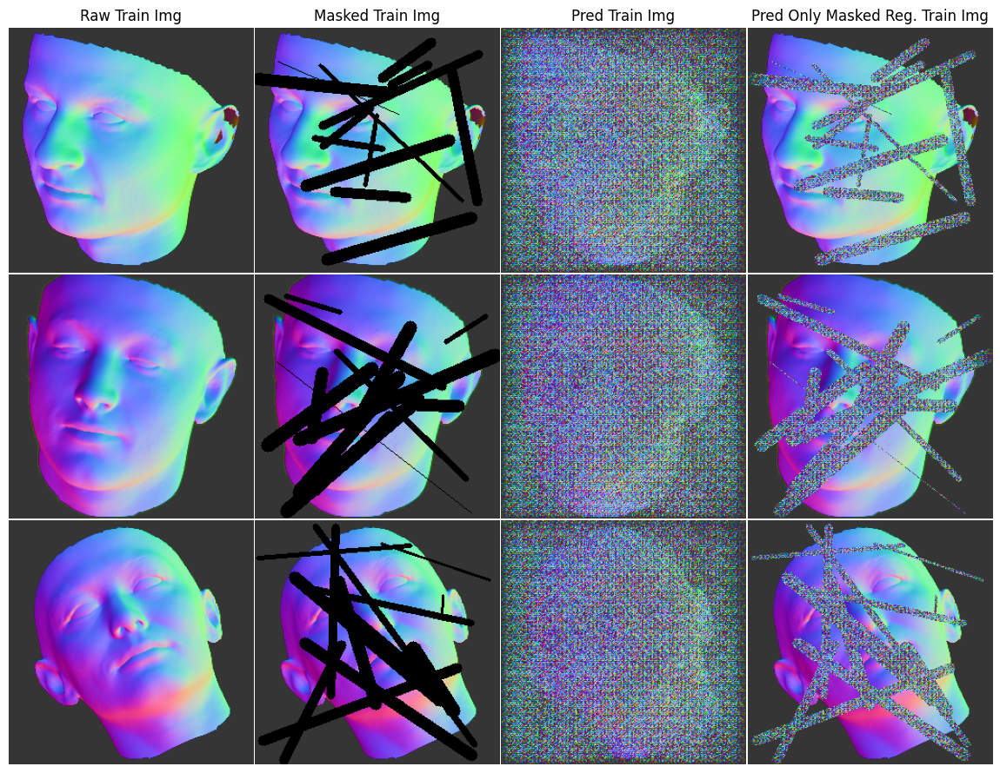

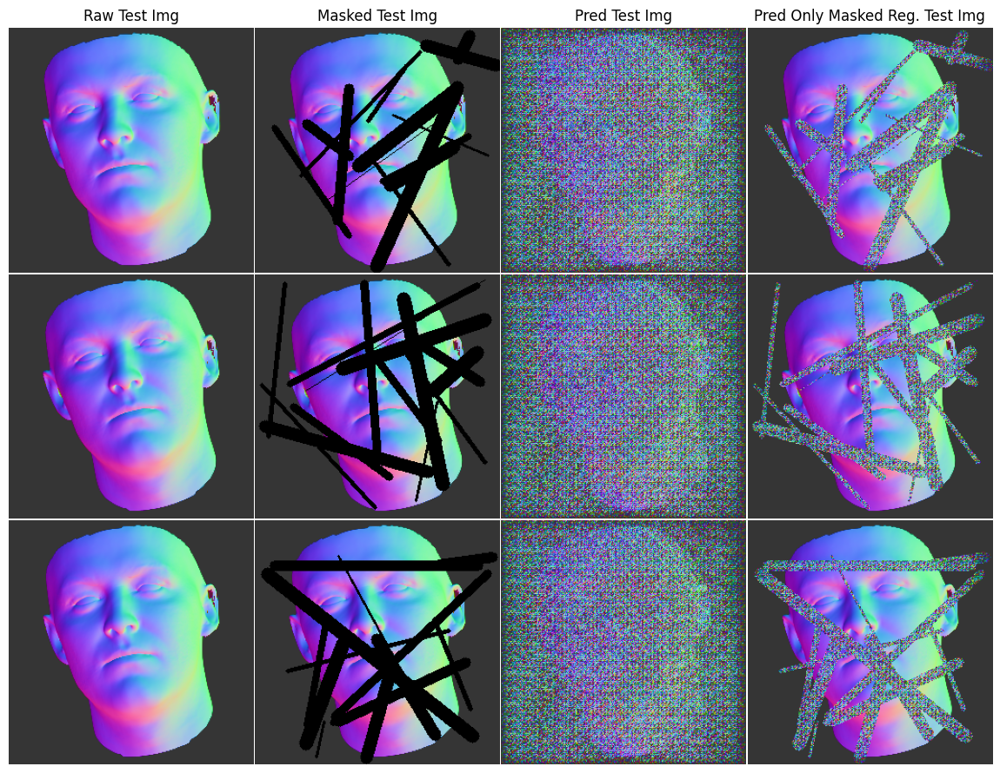

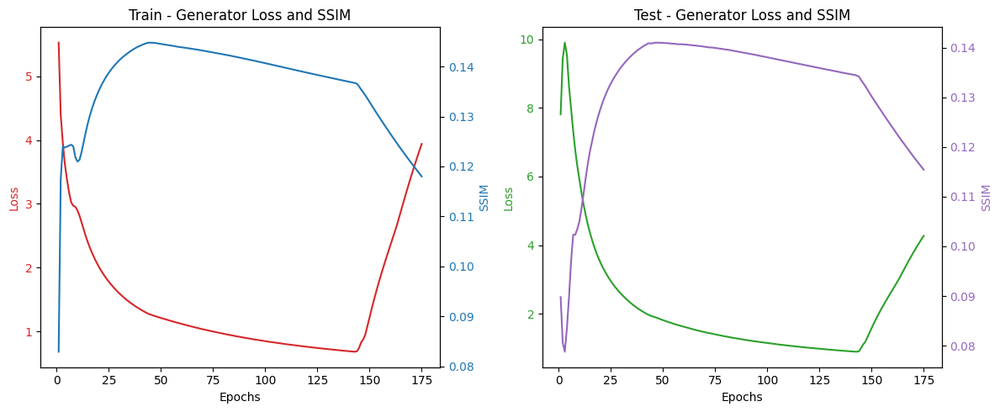

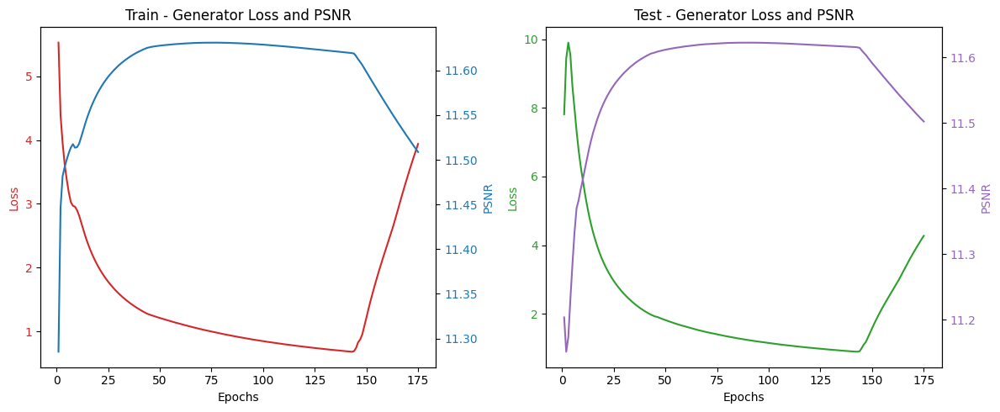

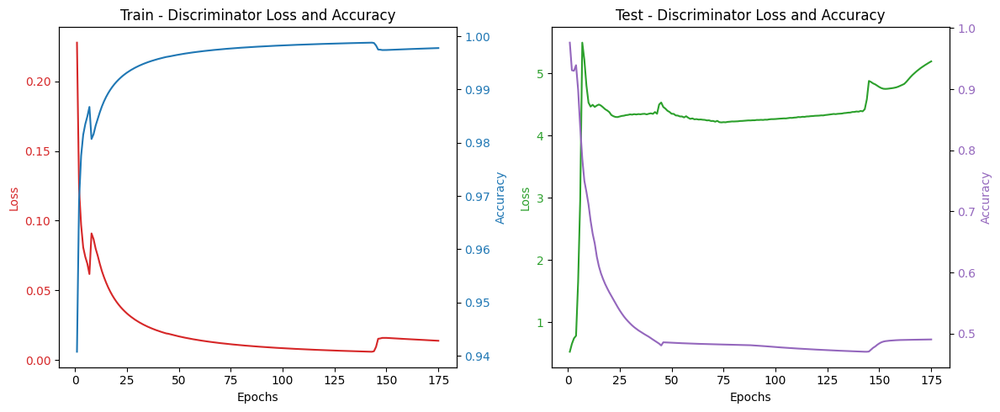

Epoch 176/300  Train[G_Loss:20.45915 SSIM:2.56% PSNR:10.94 Disc:0.00005 100.000%]  Test[G_Loss:20.54971 SSIM:2.34% PSNR:10.93 Disc:8.48172 50.000%] - 53s
Epoch 177/300  Train[G_Loss:20.32825 SSIM:2.53% PSNR:10.94 Disc:0.00004 100.000%]  Test[G_Loss:20.36159 SSIM:2.39% PSNR:10.94 Disc:8.37512 50.000%] - 53s
Epoch 178/300  Train[G_Loss:20.18267 SSIM:2.53% PSNR:10.94 Disc:0.00004 100.000%]  Test[G_Loss:20.22113 SSIM:2.33% PSNR:10.93 Disc:8.29861 50.000%] - 53s
Epoch 179/300  Train[G_Loss:20.04586 SSIM:2.51% PSNR:10.94 Disc:0.00004 100.000%]  Test[G_Loss:20.16179 SSIM:2.33% PSNR:10.93 Disc:8.18166 50.000%] - 53s
Epoch 180/300  Train[G_Loss:20.01667 SSIM:2.50% PSNR:10.93 Disc:0.00004 100.000%]  Test[G_Loss:20.29090 SSIM:2.27% PSNR:10.93 Disc:8.11570 50.000%] - 53s
Epoch 181/300  Train[G_Loss:19.97251 SSIM:2.50% PSNR:10.93 Disc:0.00003 100.000%]  Test[G_Loss:19.90520 SSIM:2.28% PSNR:10.93 Disc:8.07742 50.000%] - 53s
Epoch 182/300  Train[G_Loss:19.81935 SSIM:2.48% PSNR:10.93 Disc:0.00003 100.

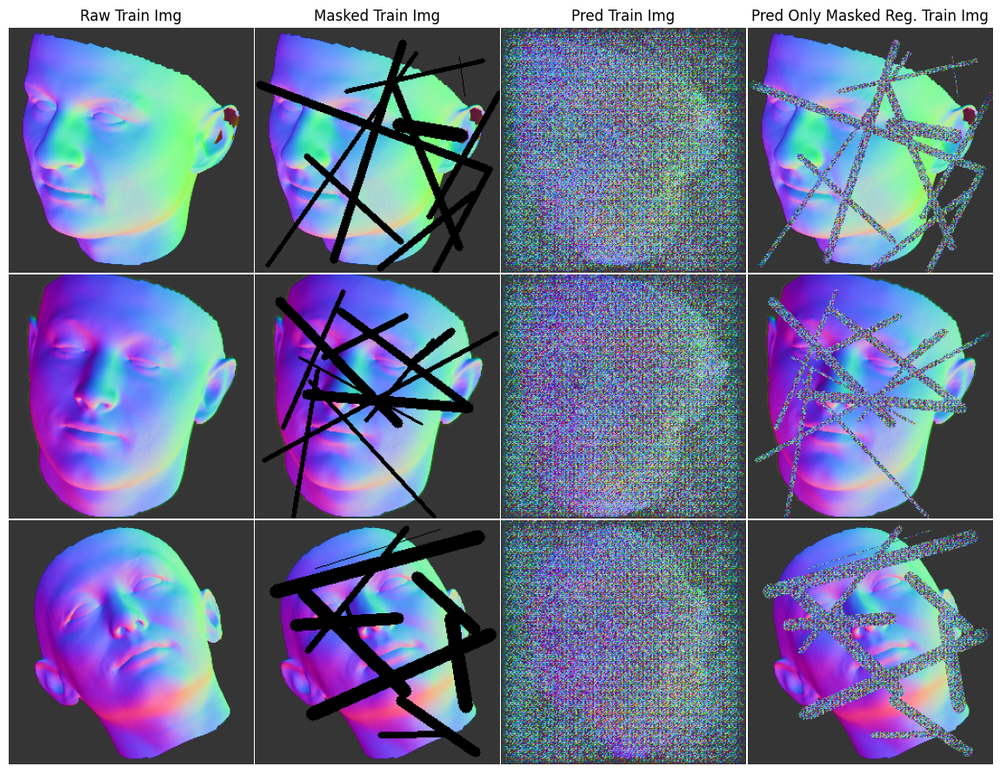

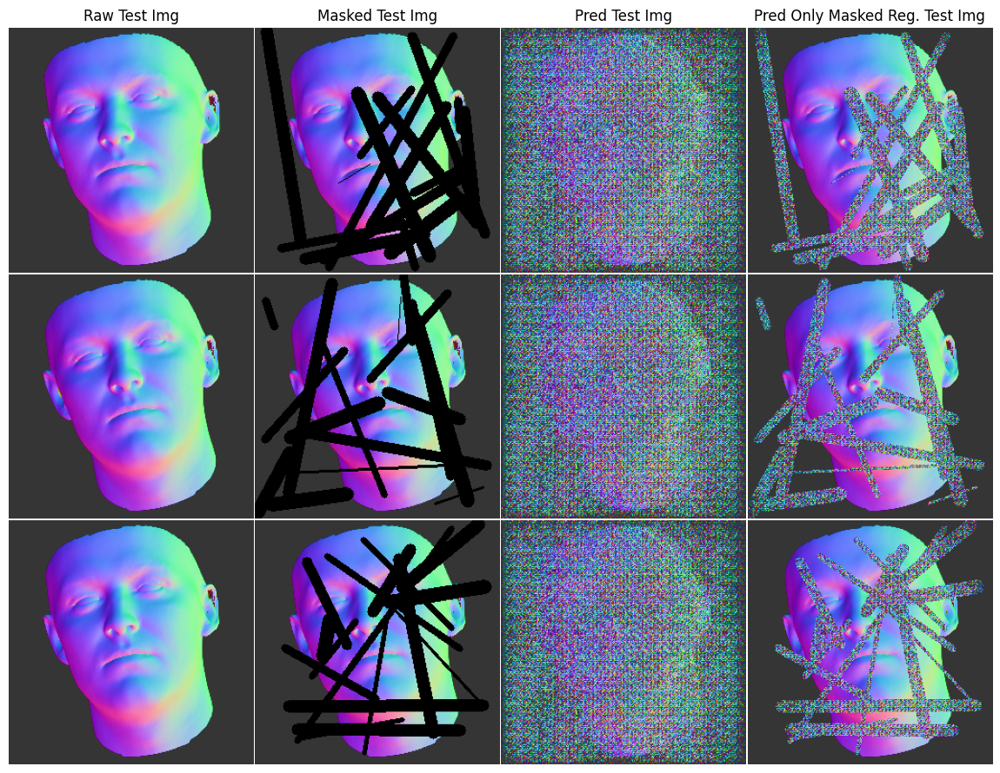

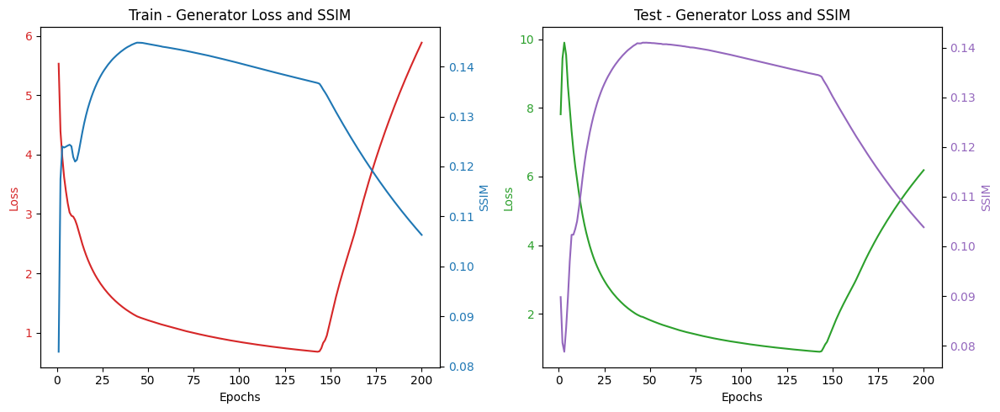

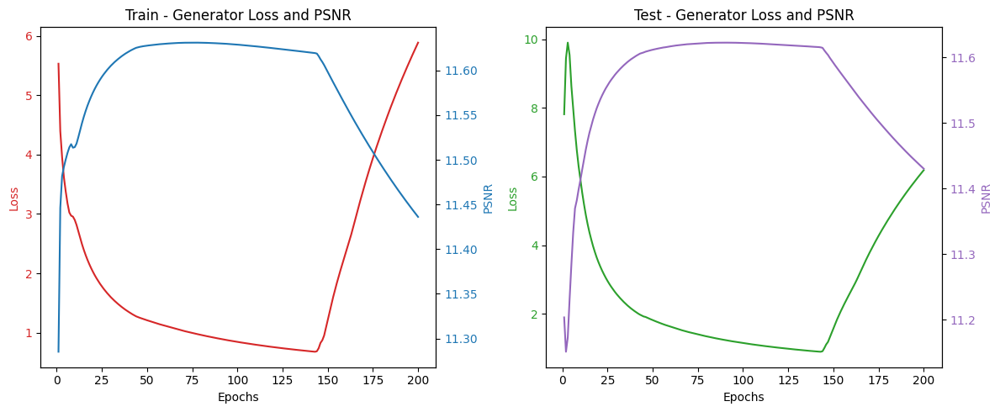

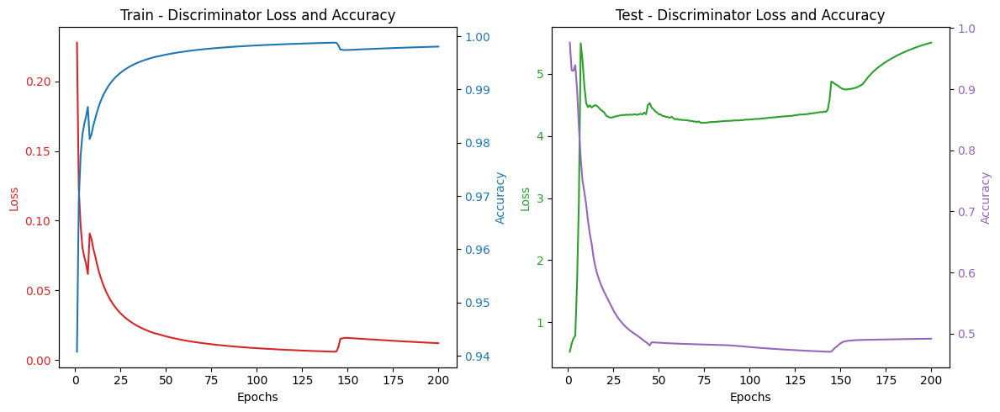

Epoch 201/300  Train[G_Loss:18.82299 SSIM:2.35% PSNR:10.92 Disc:0.00002 100.000%]  Test[G_Loss:18.87667 SSIM:2.21% PSNR:10.92 Disc:7.05320 50.000%] - 53s
Epoch 202/300  Train[G_Loss:18.78623 SSIM:2.35% PSNR:10.92 Disc:0.00002 100.000%]  Test[G_Loss:18.80930 SSIM:2.21% PSNR:10.92 Disc:7.05339 50.000%] - 54s
Epoch 203/300  Train[G_Loss:18.75631 SSIM:2.35% PSNR:10.92 Disc:0.00002 100.000%]  Test[G_Loss:18.80102 SSIM:2.17% PSNR:10.92 Disc:7.00792 50.000%] - 54s
Epoch 204/300  Train[G_Loss:18.69986 SSIM:2.34% PSNR:10.92 Disc:0.00002 100.000%]  Test[G_Loss:18.72022 SSIM:2.23% PSNR:10.92 Disc:6.95226 50.000%] - 54s
Epoch 205/300  Train[G_Loss:18.70353 SSIM:2.34% PSNR:10.92 Disc:0.00002 100.000%]  Test[G_Loss:18.79392 SSIM:2.12% PSNR:10.91 Disc:6.91371 50.000%] - 53s
Epoch 206/300  Train[G_Loss:18.69539 SSIM:2.32% PSNR:10.92 Disc:0.00002 100.000%]  Test[G_Loss:18.80750 SSIM:2.18% PSNR:10.92 Disc:6.88148 50.000%] - 53s
Epoch 207/300  Train[G_Loss:18.72213 SSIM:2.33% PSNR:10.92 Disc:0.00002 100.

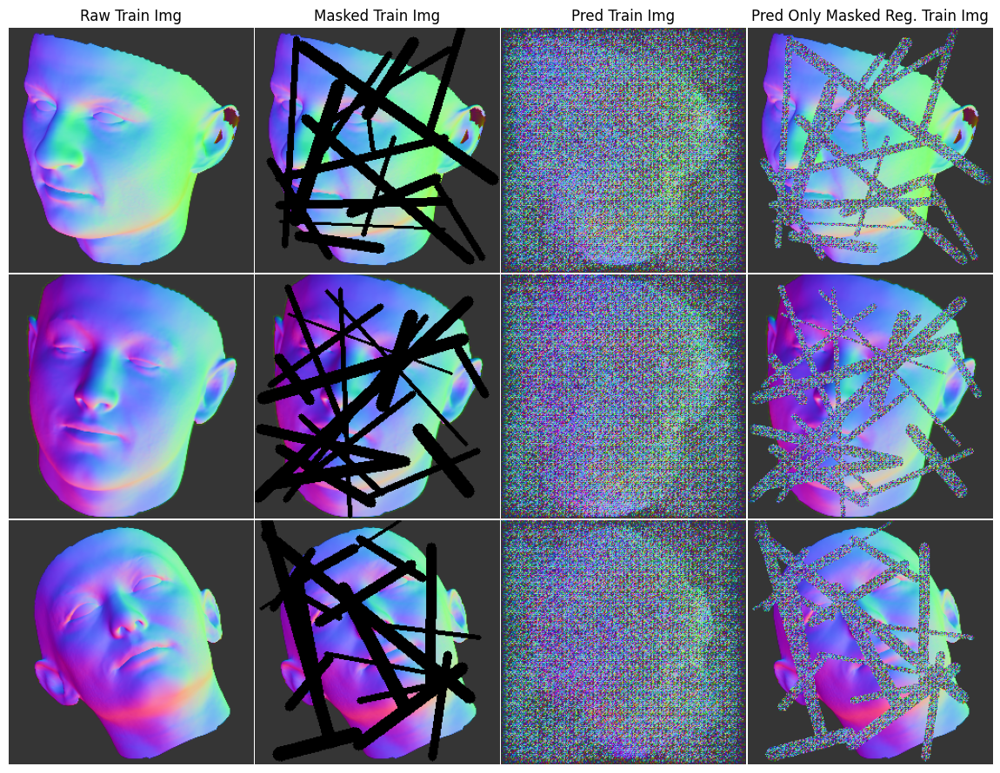

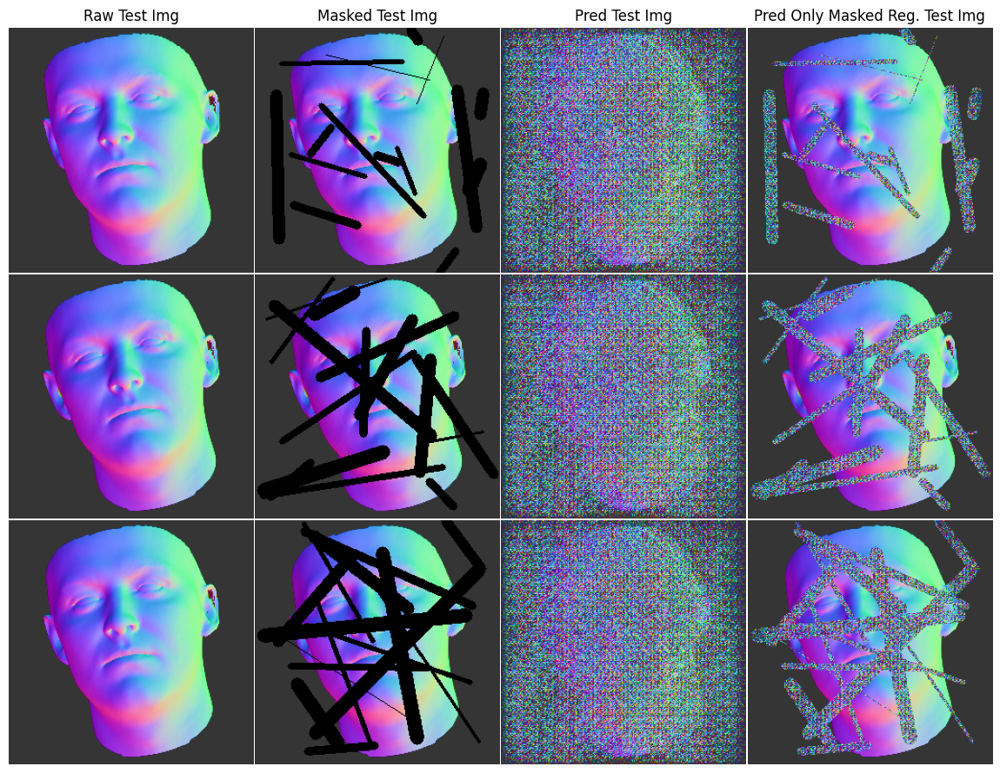

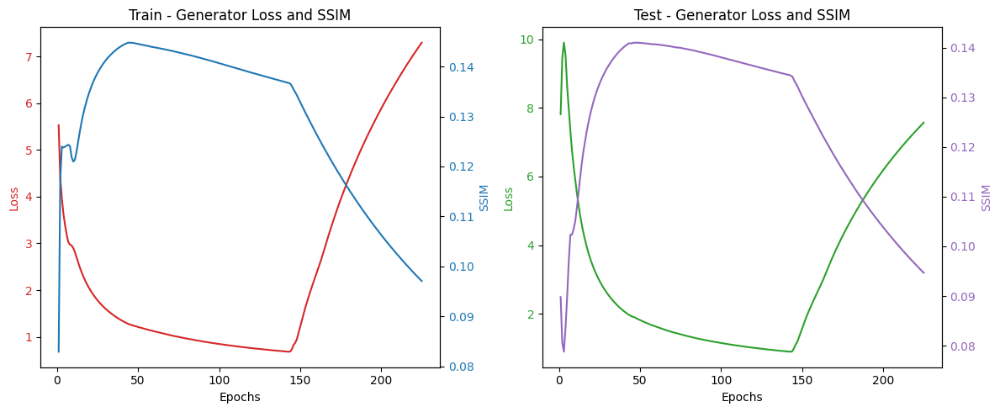

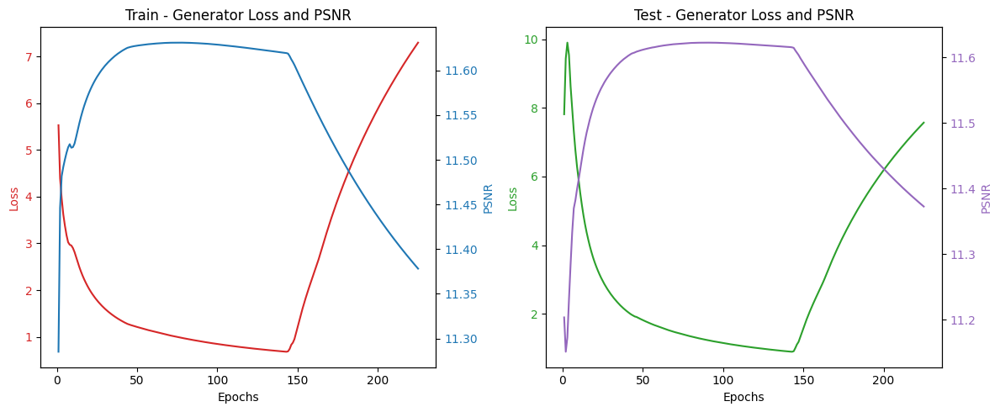

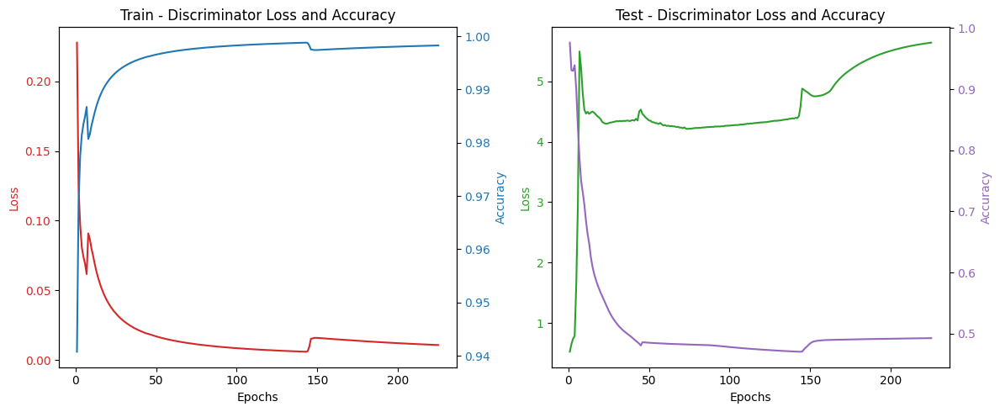

Epoch 226/300  Train[G_Loss:18.38790 SSIM:2.28% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.47981 SSIM:2.14% PSNR:10.91 Disc:6.39881 50.000%] - 54s
Epoch 227/300  Train[G_Loss:18.36775 SSIM:2.28% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.38266 SSIM:2.06% PSNR:10.90 Disc:6.39701 50.000%] - 54s
Epoch 228/300  Train[G_Loss:18.35096 SSIM:2.28% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.46523 SSIM:2.14% PSNR:10.91 Disc:6.38525 50.000%] - 54s
Epoch 229/300  Train[G_Loss:18.37586 SSIM:2.28% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.35578 SSIM:2.08% PSNR:10.91 Disc:6.35463 50.476%] - 54s
Epoch 230/300  Train[G_Loss:18.34085 SSIM:2.26% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.37953 SSIM:2.07% PSNR:10.91 Disc:6.32650 50.476%] - 54s
Epoch 231/300  Train[G_Loss:18.33875 SSIM:2.27% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.46966 SSIM:2.10% PSNR:10.91 Disc:6.31207 50.476%] - 54s
Epoch 232/300  Train[G_Loss:18.36810 SSIM:2.28% PSNR:10.91 Disc:0.00003 100.

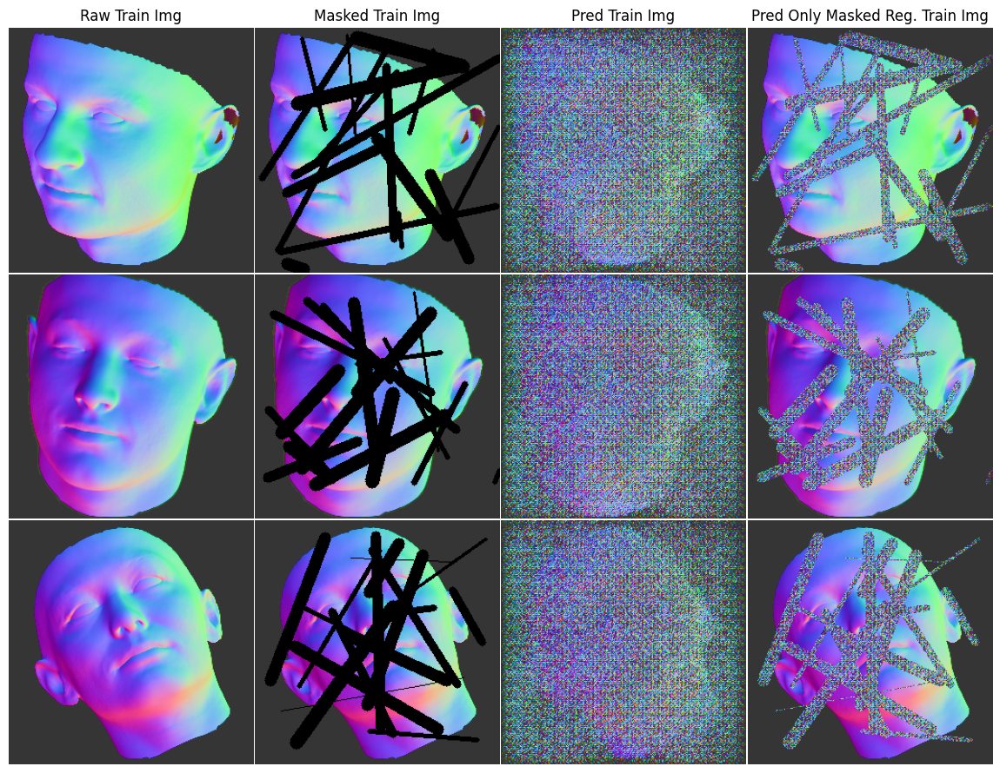

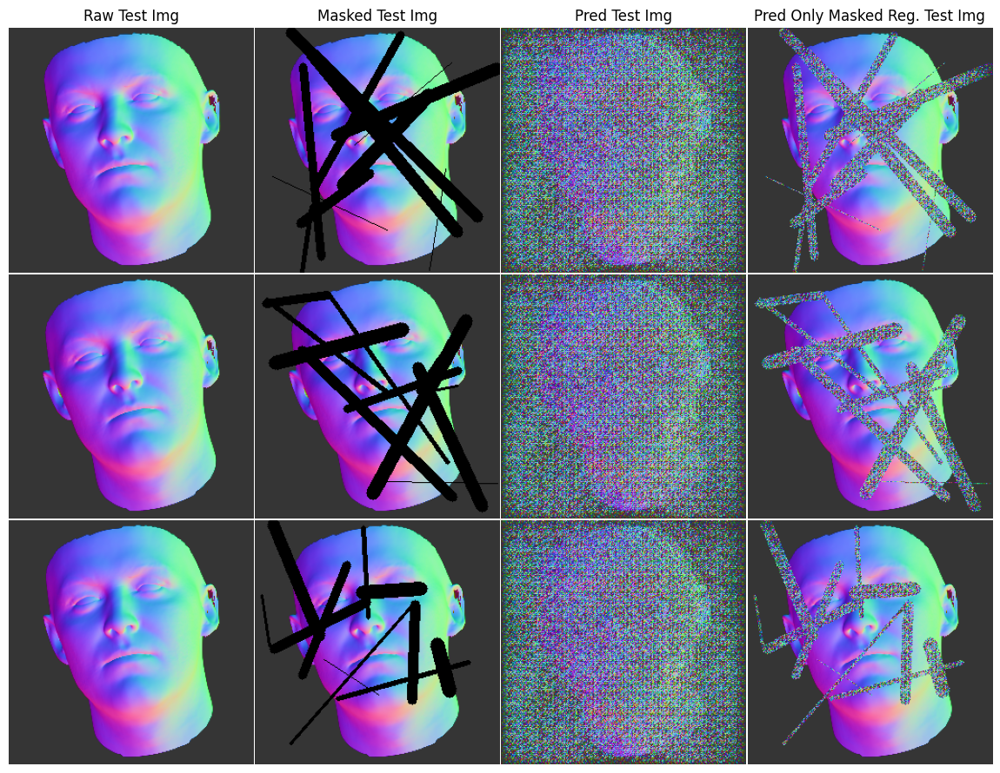

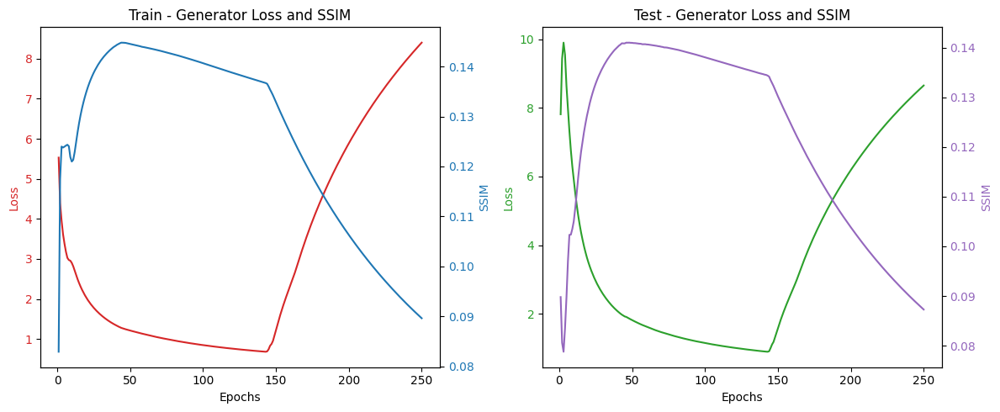

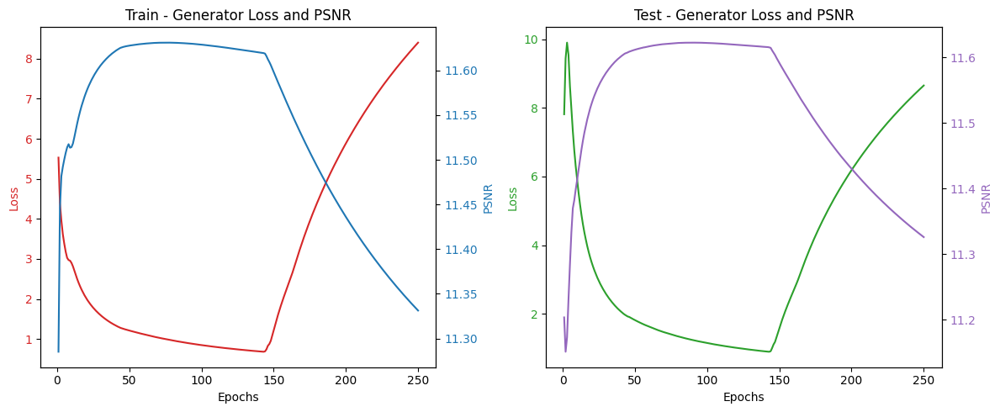

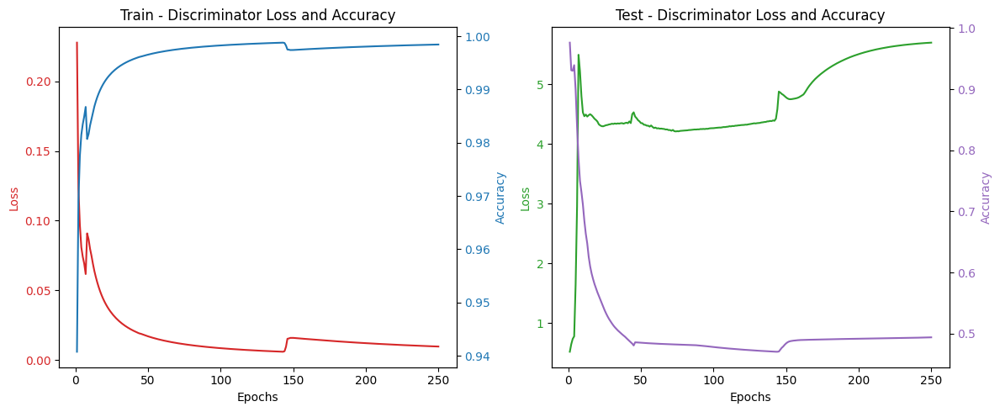

Epoch 251/300  Train[G_Loss:18.32164 SSIM:2.24% PSNR:10.91 Disc:0.00001 100.000%]  Test[G_Loss:18.37456 SSIM:2.06% PSNR:10.91 Disc:6.03411 50.952%] - 54s
Epoch 252/300  Train[G_Loss:18.31879 SSIM:2.24% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.40538 SSIM:2.12% PSNR:10.91 Disc:6.03720 50.952%] - 54s
Epoch 253/300  Train[G_Loss:18.34586 SSIM:2.24% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.37155 SSIM:2.08% PSNR:10.91 Disc:6.02798 50.952%] - 55s
Epoch 254/300  Train[G_Loss:18.31764 SSIM:2.24% PSNR:10.91 Disc:0.00002 100.000%]  Test[G_Loss:18.33433 SSIM:2.10% PSNR:10.91 Disc:6.03002 50.952%] - 54s
Epoch 255/300  Train[G_Loss:18.30847 SSIM:2.23% PSNR:10.91 Disc:0.00001 100.000%]  Test[G_Loss:18.35203 SSIM:2.10% PSNR:10.91 Disc:5.99408 50.952%] - 54s
Epoch 256/300  Train[G_Loss:18.30795 SSIM:2.23% PSNR:10.91 Disc:0.00001 100.000%]  Test[G_Loss:18.39911 SSIM:2.11% PSNR:10.91 Disc:5.98595 50.952%] - 54s
Epoch 257/300  Train[G_Loss:18.33823 SSIM:2.24% PSNR:10.91 Disc:0.00001 100.

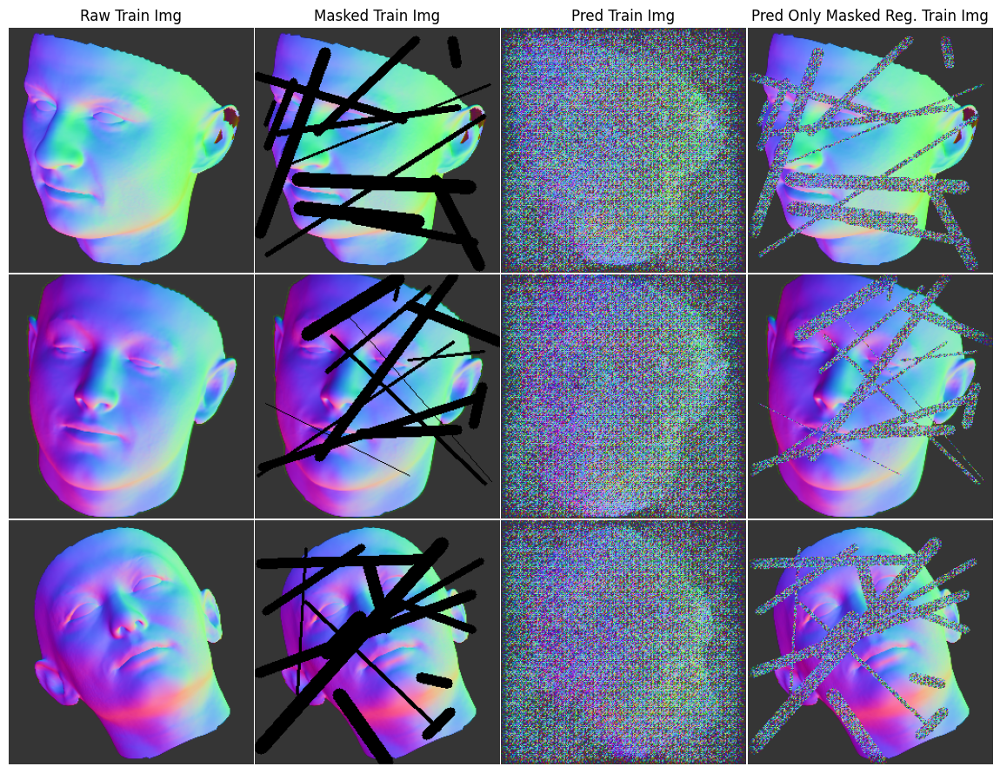

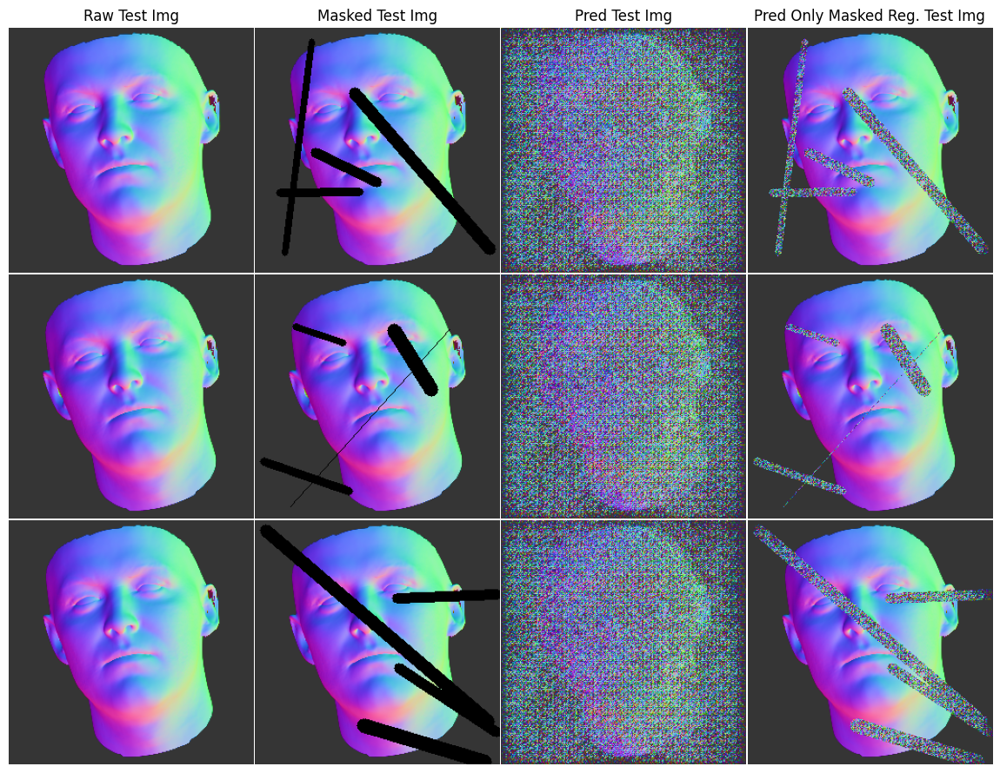

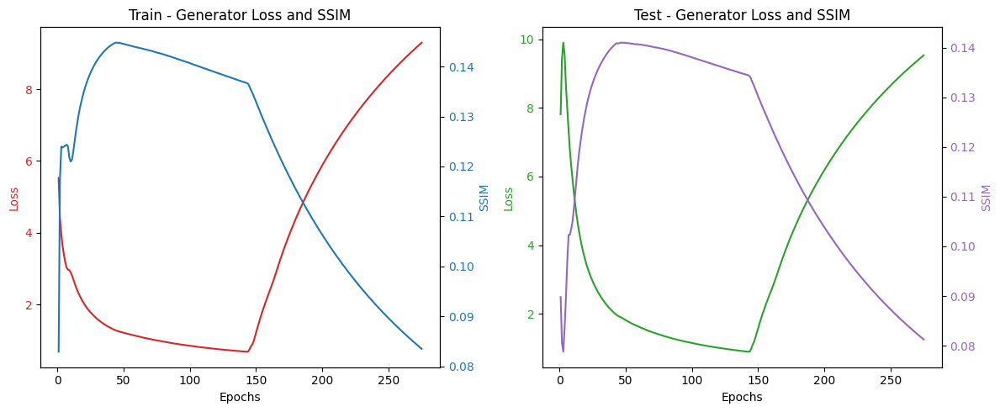

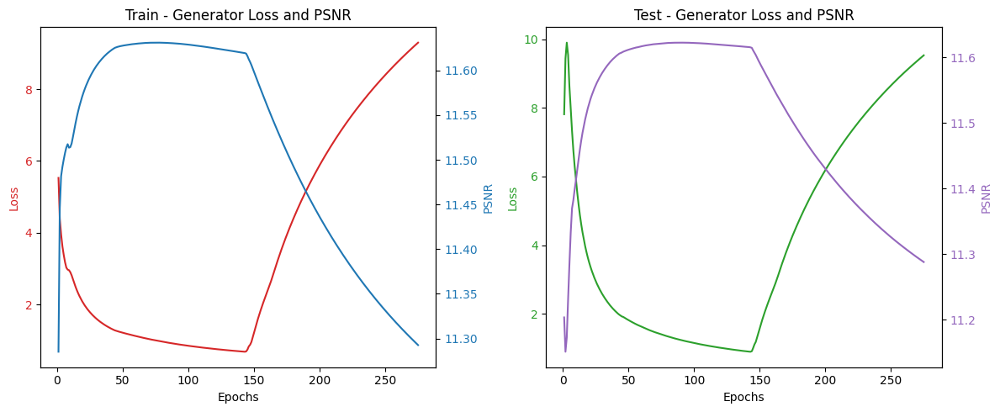

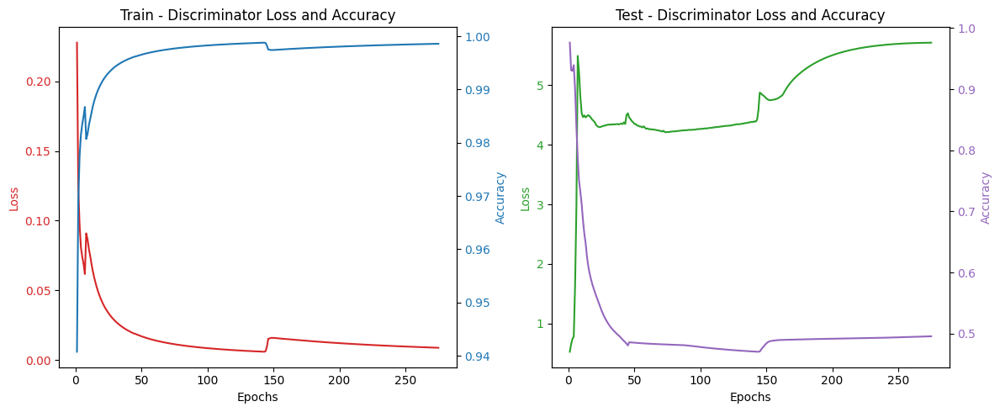

Epoch 276/300  Train[G_Loss:18.33507 SSIM:2.21% PSNR:10.90 Disc:0.00001 100.000%]  Test[G_Loss:18.35714 SSIM:2.13% PSNR:10.91 Disc:5.78313 51.429%] - 53s
Epoch 277/300  Train[G_Loss:18.33076 SSIM:2.22% PSNR:10.90 Disc:0.00001 100.000%]  Test[G_Loss:18.36839 SSIM:2.07% PSNR:10.91 Disc:5.79133 51.429%] - 54s
Epoch 278/300  Train[G_Loss:18.34031 SSIM:2.21% PSNR:10.90 Disc:0.00001 100.000%]  Test[G_Loss:18.39937 SSIM:2.11% PSNR:10.91 Disc:5.76212 51.429%] - 54s
Epoch 279/300  Train[G_Loss:18.36267 SSIM:2.22% PSNR:10.90 Disc:0.00001 100.000%]  Test[G_Loss:18.38872 SSIM:2.06% PSNR:10.90 Disc:5.77762 51.429%] - 53s
Epoch 280/300  Train[G_Loss:18.33735 SSIM:2.21% PSNR:10.90 Disc:0.00001 100.000%]  Test[G_Loss:18.32049 SSIM:2.01% PSNR:10.90 Disc:5.75910 51.429%] - 53s
Epoch 281/300  Train[G_Loss:18.33854 SSIM:2.21% PSNR:10.90 Disc:0.00002 100.000%]  Test[G_Loss:18.36543 SSIM:2.02% PSNR:10.90 Disc:5.76419 51.429%] - 53s
Epoch 282/300  Train[G_Loss:18.36749 SSIM:2.22% PSNR:10.90 Disc:0.00001 100.

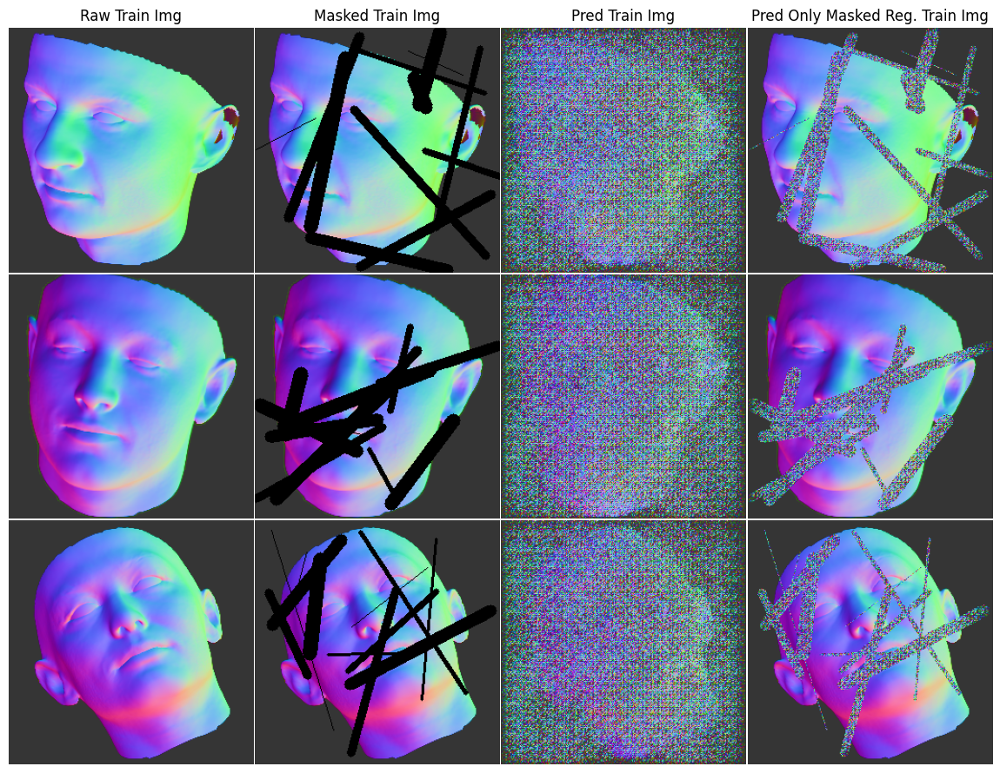

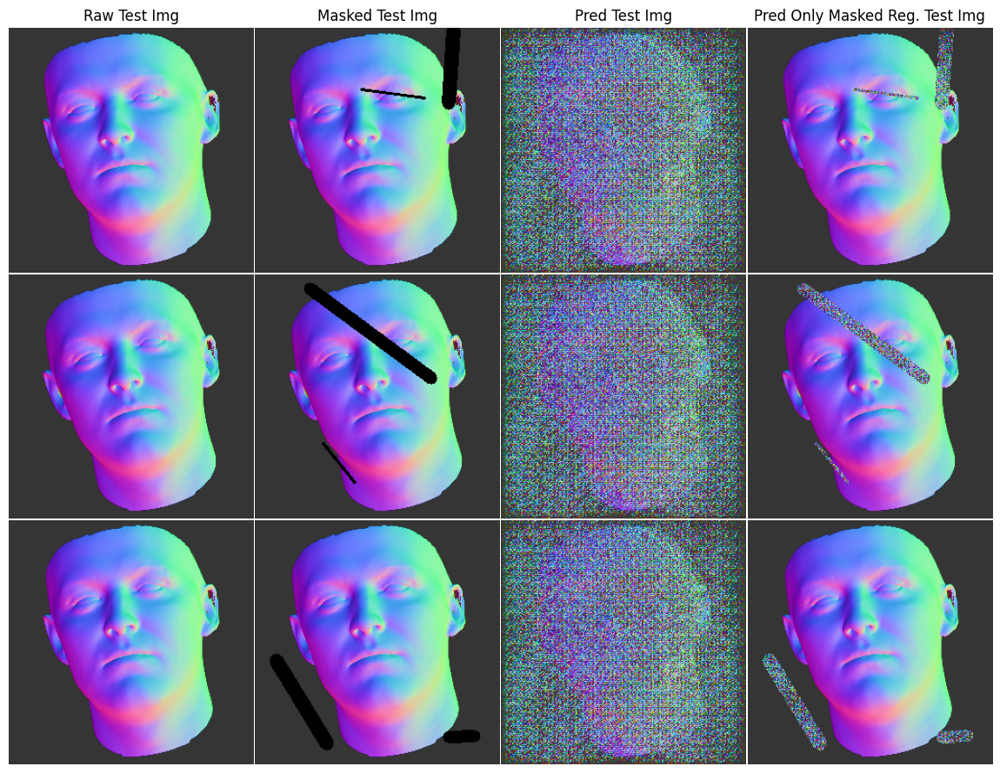

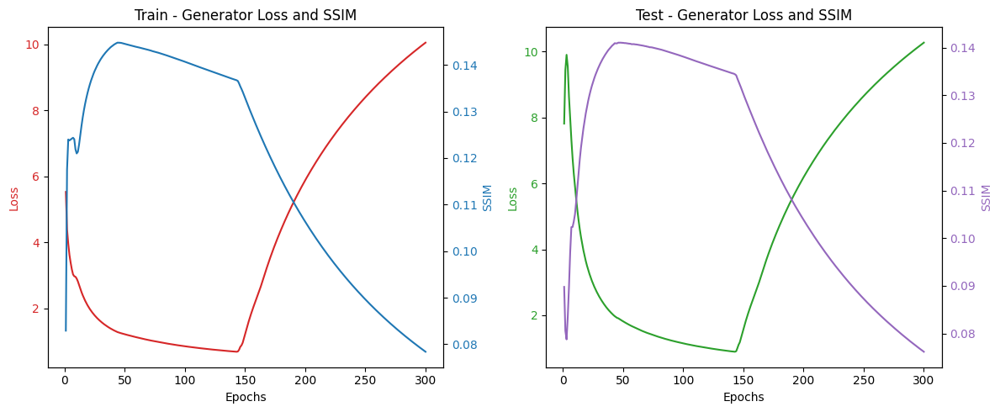

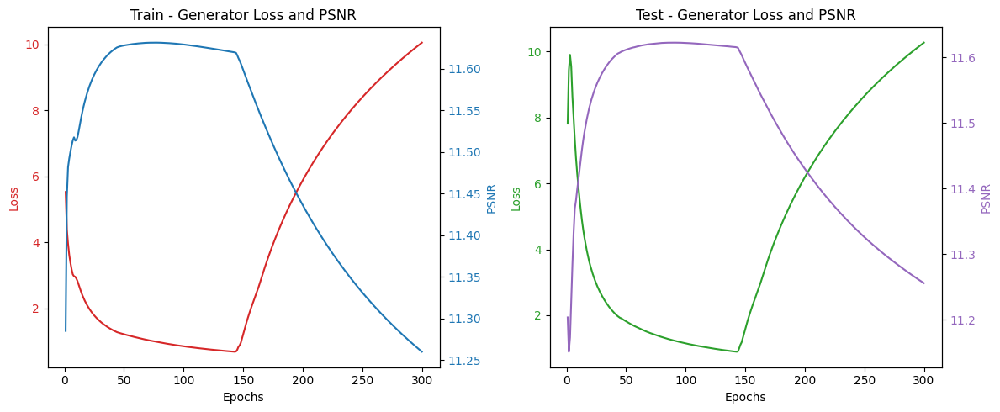

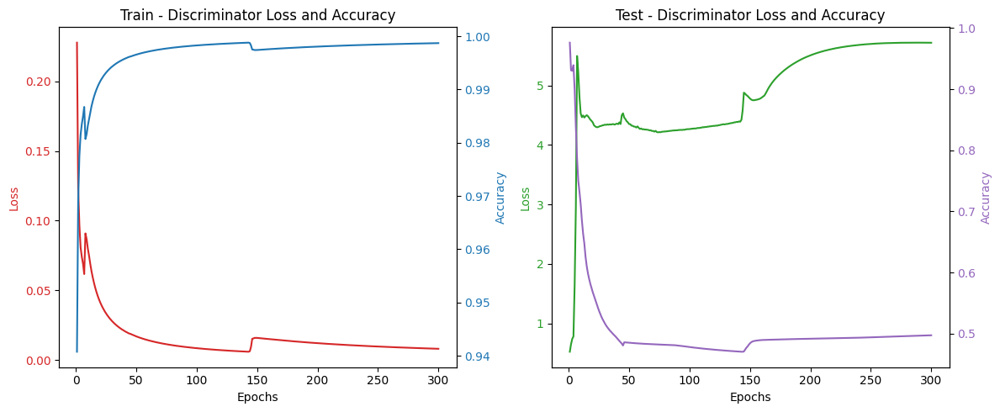

In [43]:
model_path = './saved_model/generator.h5'
if not os.path.exists(model_path):
    train(train_dataset, epochs = 300, epoch_break = 25, batches_list_num = 15)
    generator.save('./saved_model/generator.h5')

# Testing and Evaluation on Test Dataset

### Load trained generator

In [44]:
gen_model_pth = './saved_models/generator.h5'
if os.path.exists(gen_model_pth):
    print('Load generator model')
    generator = load_model(gen_model_pth, custom_objects={'UnitNormalize': UnitNormalize})

In [45]:
test_metrics = assessment(test_dataset)

print("Test dataset Avg LOSS: {:.2f}\n"
      "Test dataset Avg SSIM: {:.2f}%\n"
      "Test dataset Avg PSNR: {:.2f}\n"
      "Test dataset Disc Avg Loss: {:.2f}\n"
      "Test dataset Disc Avg ACC: {:.2f}%".format(test_metrics['gen_loss'], 
                                                  test_metrics['gen_ssim'] * 100, 
                                                  test_metrics['gen_psnr'], 
                                                  test_metrics['disc_loss'], 
                                                  test_metrics['disc_acc'] * 100))

Test dataset Avg LOSS: 18.47
Test dataset Avg SSIM: 2.08%
Test dataset Avg PSNR: 10.91
Test dataset Disc Avg Loss: 5.63
Test dataset Disc Avg ACC: 51.90%


In [46]:
print('Pred time for a batch')
for images_batch in test_dataset.take(1):
    test_raw_images = images_batch
    test_mask_channels = mask_irregular(test_raw_images.shape[0], test_raw_images.shape[1], test_raw_images.shape[2])
    test_masked_images = masked_imgs(test_raw_images, test_mask_channels)
    test_pred_images = generator.predict([test_masked_images, test_mask_channels], batch_size=BATCH_SIZE)

Pred time for a batch
1/1 [==============================] - 0s 253ms/step


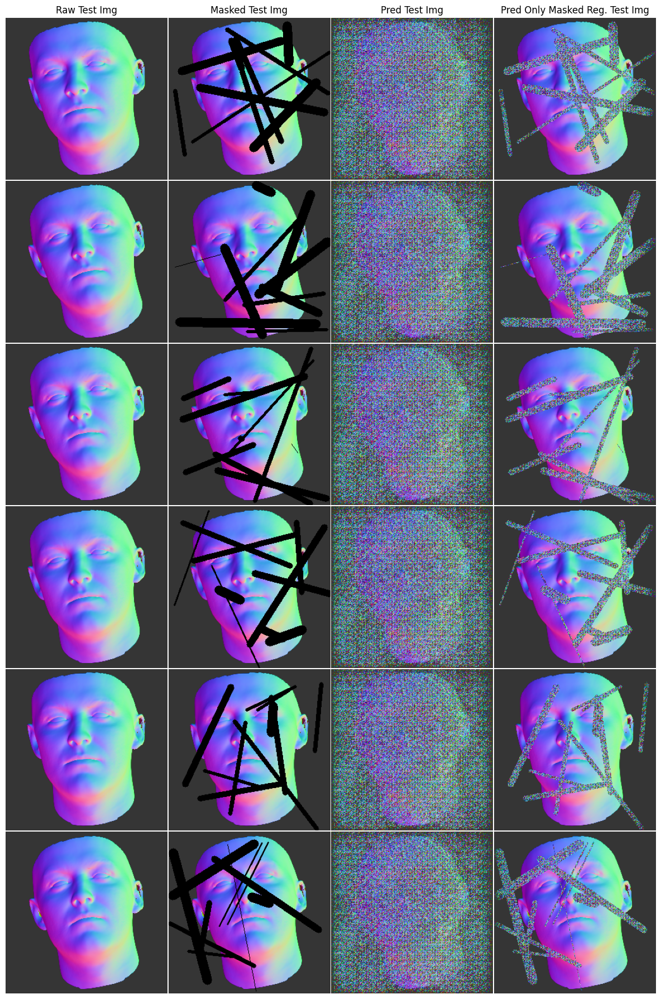

In [47]:
generator_plot_images(generator, 'Test', test_dataset, num = 6)

### Reading and plotting data from log data file

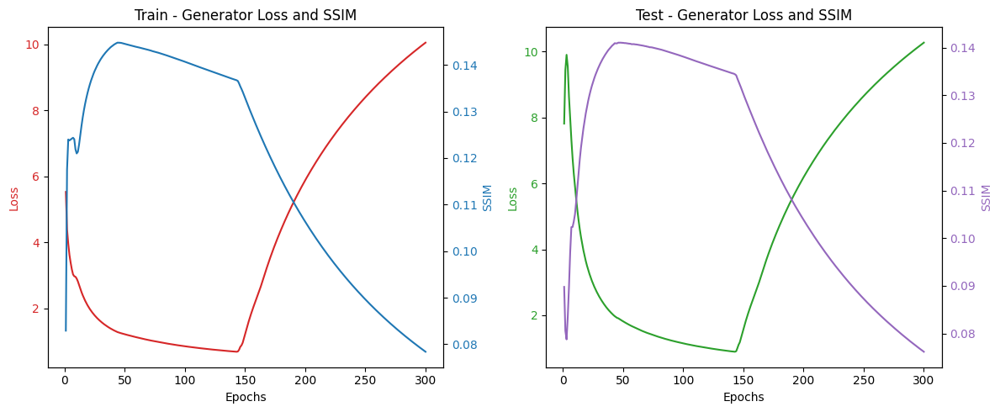

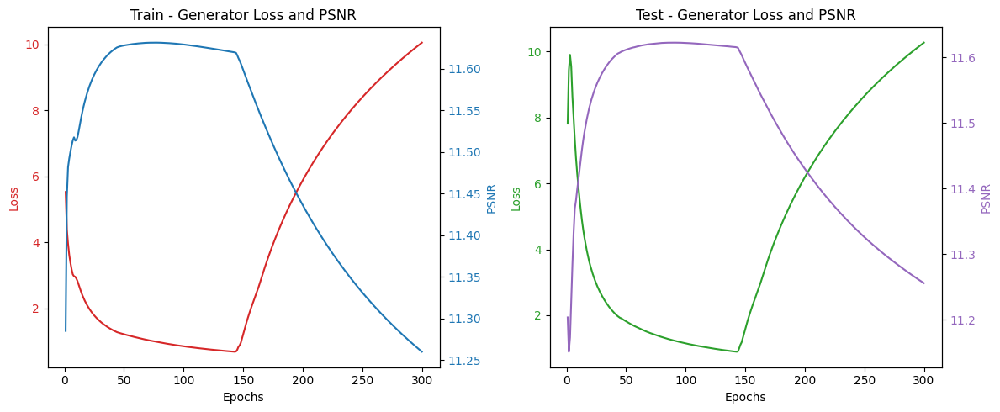

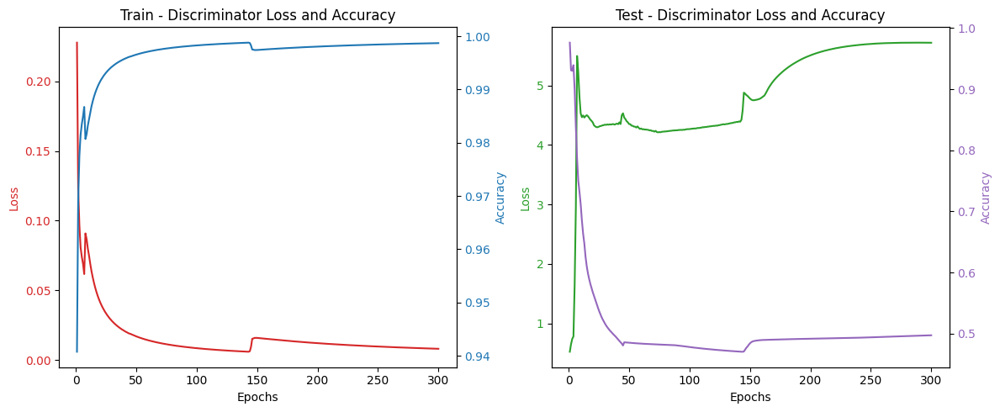

In [48]:
log_dir = './saved_logs'
os.makedirs(log_dir, exist_ok=True)
log_file = os.path.join(log_dir, "GAN_training_results.csv")
plot_metrics(load_metrics_from_csv(log_file))